<a href="https://colab.research.google.com/github/hvkchaitanya7/grp3capstone-final/blob/main/code/transformers/ImageCaptiongenerator_Transformer_Resnet50_No_MHA_Flickr30.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# New Section

To download Flickr Data set and unzip it . It has 8000 images and we will be using 5000 for training , 1000 validation and 2000 for testing 

In [2]:
import os
os.chdir('/content/drive/MyDrive/Project_Data/Flickr30k')

In [3]:
!pwd

/content/drive/MyDrive/Project_Data/Flickr30k


In [4]:
!ls

Flickr30_comments  Flickr30_images  Flickr30k_images.zip  Images_incomplete


In [ ]:
#!!7z x "/content/drive/MyDrive/Project_Data/Flickr30k/Images.zip"


7-Zip [64] 16.02 : Copyright (c) 1999-2016 Igor Pavlov : 2016-05-21
p7zip Version 16.02 (locale=en_US.UTF-8,Utf16=on,HugeFiles=on,64 bits,2 CPUs Intel(R) Xeon(R) CPU @ 2.30GHz (306F0),ASM,AES-NI)

Scanning the drive for archives:
  0M Scan /content/drive/MyDrive/Project_Data/Flickr30k/                                                        1 file, 4375126936 bytes (4173 MiB)

Extracting archive: /content/drive/MyDrive/Project_Data/Flickr30k/Images.zip
  0% 256 Open               1% 512 Open               2% 768 Open               3% 1024 Open                4% 1280 Open                4% 1536 Open                5% 1792 Open                6% 2048 Open              

                                   51% 16835 - Images/3743157427.jpg                                   51% 16836 - Images/3743169025.jpg                                   51% 16837 - Images/3743976841.jpg                                   51% 16838 - Images/3744182161.jpg                                   51% 16839 - Images/374437796.jpg                                  51% 16840 - Images/374437808.jpg                                  51% 16841 - Images/374437845.jpg                        

In [5]:
#Importing all libraries for Keras , Tensorflow and Resnet50

In [6]:
import string
import numpy as np
import pandas as pd 
from numpy import array
from PIL import Image
import pickle

import matplotlib.pyplot as plt
import keras
import sys, time, os, warnings 
warnings.filterwarnings("ignore")
import re

import tensorflow as tf
from tqdm import tqdm

from nltk.translate.bleu_score import sentence_bleu

from keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.utils import plot_model
from keras.models import Model
from keras.layers import Input
from keras.layers import Dense, BatchNormalization
from keras.layers import LSTM
from keras.layers import Embedding
from keras.layers import Dropout
from keras.layers.merge import add
from keras.callbacks import ModelCheckpoint
from keras.preprocessing.image import load_img, img_to_array
from keras.preprocessing.text import Tokenizer
from tensorflow.keras.applications.resnet50 import ResNet50
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from sklearn.utils import shuffle

In [7]:
image_path = "/content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images"
dir_Flickr_text = "/content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_comments/captions.txt"

jpgs = os.listdir(image_path)
print("Total Images in Dataset = {}".format(len(jpgs)))

Total Images in Dataset = 31783


In [8]:
#check Image file name to Caption combination derived from the Flick8 dataset

In [15]:
file = open(dir_Flickr_text,'r')
text = file.read()
file.close()

datatxt = []
for line in text.split('\n'):
    col = line.split('|')
    if len(col) == 1:
        continue
    #w = col[0].split("#")
    datatxt.append(col)

data = pd.DataFrame(datatxt,columns=["filename","index","caption"])
data = data.reindex(columns =['index','filename','caption'])
data = data[data['filename'] != '2258277193_586949ec62.jpg.1']


uni_filenames = np.unique(data.filename.values)
data.head()

,index,filename,caption
0,0,1000092795.jpg,Two young guys with shaggy hair look at their ...
1,1,1000092795.jpg,"Two young , White males are outside near many ..."
2,2,1000092795.jpg,Two men in green shirts are standing in a yard .
3,3,1000092795.jpg,A man in a blue shirt standing in a garden .
4,4,1000092795.jpg,Two friends enjoy time spent together .


Print some images along with captions to check the Flickr Data that was imported

In [26]:
data.size

476745

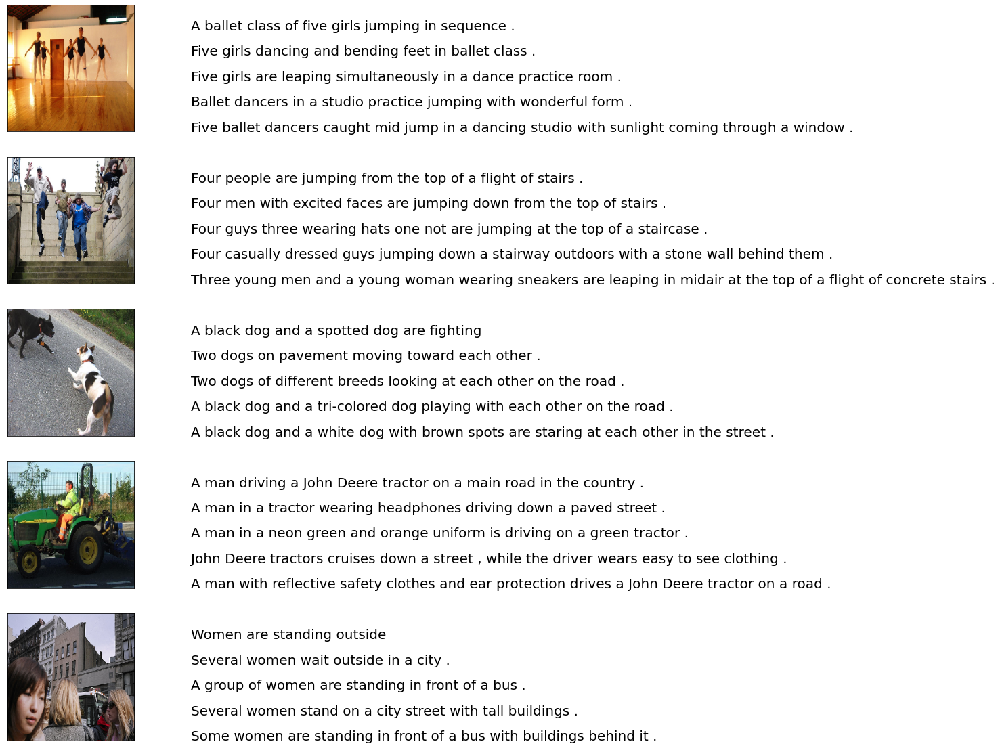

In [16]:
from keras.preprocessing.image import load_img, img_to_array

npic = 5
npix = 224
target_size = (npix,npix,3)

count = 1
fig = plt.figure(figsize=(10,20))
for jpgfnm in uni_filenames[10:15]:
    filename = image_path + '/' + jpgfnm
    captions = list(data["caption"].loc[data["filename"]==jpgfnm].values)
    image_load = load_img(filename, target_size=target_size)
    
    ax = fig.add_subplot(npic,2,count,xticks=[],yticks=[])
    ax.imshow(image_load)
    count += 1
    
    ax = fig.add_subplot(npic,2,count)
    plt.axis('off')
    ax.plot()
    ax.set_xlim(0,1)
    ax.set_ylim(0,len(captions))
    for i, caption in enumerate(captions):
        ax.text(0,i,caption,fontsize=20)
    count += 1
plt.show()

In [17]:
# Get all the words available i the captions by splitting the sentences

In [18]:
vocabulary = []
for txt in data.caption.values:
    vocabulary.extend(txt.split())
print('Vocabulary Size: %d' % len(set(vocabulary)))

Vocabulary Size: 23538


In [19]:
# crearting a list of Image file names and captions

In [20]:
img = data["filename"].tolist()
caption = data["caption"].tolist()

In [21]:
print(f"len(img) : {len(img)}")
print(f"len(caption) : {len(caption)}")

len(img) : 158915
len(caption) : 158915


In [22]:
""" Removing punctuations , Single characters , Numeric values from the word/Vocabulary , having them would make increase the probability of such words over others due to repetitive usage
giving undesired results """
# To remove punctuations
def remove_punctuation(text_original):
    text_no_punctuation = text_original.translate(string.punctuation)
    return(text_no_punctuation)

# To remove single characters
def remove_single_character(text):
    text_len_more_than1 = ""
    for word in text.split():
        if len(word) > 1:
            text_len_more_than1 += " " + word
    return(text_len_more_than1)

# To remove numeric values
def remove_numeric(text):
    text_no_numeric = ""
    for word in text.split():
        isalpha = word.isalpha()
        if isalpha:
            text_no_numeric += " " + word
    return(text_no_numeric)

In [23]:
""" Cleaning up the original text without punctuations, single characters and numeric values """

' Cleaning up the original text without punctuations, single characters and numeric values '

In [24]:
def text_clean(text_original):
    text = remove_punctuation(text_original)
    text = remove_single_character(text)
    text = remove_numeric(text)
    return(text)
    
for i, caption in enumerate(data.caption.values):
    newcaption = text_clean(caption)
    data["caption"].iloc[i] = newcaption

In [25]:
#building clean vocabulary
clean_vocabulary = []
for txt in data.caption.values:
    clean_vocabulary.extend(txt.split())
print('Clean Vocabulary Size: %d' % len(set(clean_vocabulary)))

Clean Vocabulary Size: 20924


In [29]:
# adding <start> and <end> tags to sentences to identify the start and end of the sentences while looping through words in sentence
PATH = "/content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/"
all_captions = []

for caption  in data["caption"].astype(str):
    caption = '<start> ' + caption+ ' <end>'
    all_captions.append(caption)
all_captions[:10]

['<start>  Two young guys with shaggy hair look at their hands while hanging out in the yard <end>',
 '<start>  Two young White males are outside near many bushes <end>',
 '<start>  Two men in green shirts are standing in yard <end>',
 '<start>  man in blue shirt standing in garden <end>',
 '<start>  Two friends enjoy time spent together <end>',
 '<start>  Several men in hard hats are operating giant pulley system <end>',
 '<start>  Workers look down from up above on piece of equipment <end>',
 '<start>  Two men working on machine wearing hard hats <end>',
 '<start>  Four men on top of tall structure <end>',
 '<start>  Three men on large rig <end>']

In [30]:
#building path to read each image from the content downloaded
all_img_name_vector = []

for annot in data["filename"]:
    full_image_path = PATH + annot

    all_img_name_vector.append(full_image_path)
all_img_name_vector[:10]

['/content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/1000092795.jpg',
 '/content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/1000092795.jpg',
 '/content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/1000092795.jpg',
 '/content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/1000092795.jpg',
 '/content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/1000092795.jpg',
 '/content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/10002456.jpg',
 '/content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/10002456.jpg',
 '/content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/10002456.jpg',
 '/content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/10002456.jpg',
 '/content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/10002456.jpg']

In [31]:
print(f"len(all_img_name_vector) : {len(all_img_name_vector)}")
print(f"len(all_captions) : {len(all_captions)}")

len(all_img_name_vector) : 158915
len(all_captions) : 158915


In [32]:
def data_limiter(num,total_captions,all_img_name_vector):
  train_captions, img_name_vector = shuffle(total_captions,all_img_name_vector,random_state=1)
  train_captions = train_captions[:num]
  img_name_vector = img_name_vector[:num]
  return train_captions,img_name_vector

In [33]:
train_captions,img_name_vector = data_limiter(40000,all_captions,all_img_name_vector)

In [34]:
print(f"len(all_img_name_vector) : {len(img_name_vector)}")
print(f"len(all_captions) : {len(train_captions)}")

len(all_img_name_vector) : 40000
len(all_captions) : 40000


In [35]:
#Loading an image with (224,224,3) for passing to Encoder Resnet50
def load_image(image_path):
    img = tf.io.read_file(image_path)
    img = tf.image.decode_jpeg(img, channels=3)
    img = tf.image.resize(img, (224, 224))
    return img, image_path

In [37]:
#image_model_ic = tf.keras.applications.InceptionV3(include_top=False,weights='imagenet')
#Using Pretrained Resnet50 as encoder and taking Input size of (224,224,3)
image_model = ResNet50(include_top=False,weights='imagenet',input_shape=(224, 224,3),pooling="avg")
new_input = image_model.input
hidden_layer = image_model.layers[-2].output

image_features_extract_model = tf.keras.Model(new_input, hidden_layer)

In [38]:
image_model.summary()

Model: "resnet50"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 230, 230, 3)  0           ['input_3[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 112, 112, 64  9472        ['conv1_pad[0][0]']              
                                )                                                                 
                                                                                           

In [42]:
# Get unique images
encode_train = sorted(set(img_name_vector))

# Batch size 16
image_dataset = tf.data.Dataset.from_tensor_slices(encode_train)
image_dataset = image_dataset.map(
  load_image, num_parallel_calls=tf.data.experimental.AUTOTUNE).batch(16)
#Building Image feature vector using Resnet50 Encoder
for img, path in tqdm(image_dataset):
  batch_features = image_features_extract_model(img)
  # converting image from Resnet (16,7,7,2048) to (16,49,2048)
  batch_features = tf.reshape(batch_features,
                              (batch_features.shape[0], -1, batch_features.shape[3]))

  for bf, p in zip(batch_features, path):
    path_of_feature = p.numpy().decode("utf-8")
    np.save(path_of_feature, bf.numpy())

100%|██████████| 1520/1520 [2:15:57<00:00,  5.37s/it]


In [ ]:
#temp code
for img1, path1 in tqdm(image_dataset):
  batch_features1 = image_features_extract_model(img1)
  print("shape",batch_features1.shape)
  print("batch_features.shape[0]",batch_features1.shape[0])
  print("batch_features.shape[1]",batch_features1.shape[1])
  print("batch_features.shape[2]",batch_features1.shape[2])
  print("batch_features.shape[3]",batch_features1.shape[3])
  batch_features2 = tf.reshape(batch_features1,
                              (batch_features1.shape[0], -1, batch_features1.shape[3]))
  print("shape",batch_features2.shape)
  print("batch_features2.shape[0]",batch_features2.shape[0])
  print("batch_features2.shape[1]",batch_features2.shape[1])
  print("batch_features2.shape[2]",batch_features2.shape[2])
  #print("batch_features2.shape[3]",batch_features2.shape[3])
  break

  0%|          | 0/506 [00:00<?, ?it/s]

shape (16, 7, 7, 2048)
batch_features.shape[0] 16
batch_features.shape[1] 7
batch_features.shape[2] 7
batch_features.shape[3] 2048
shape (16, 49, 2048)
batch_features2.shape[0] 16
batch_features2.shape[1] 49
batch_features2.shape[2] 2048


### Preprocess and tokenize the captions

In [43]:
top_k = 5000

In [44]:
#Building a Word embedding for top 5000 words in the captions
tokenizer = tf.keras.preprocessing.text.Tokenizer(num_words=top_k,
                                                  oov_token="<unk>",
                                                  filters='!"#$%&()*+.,-/:;=?@[\]^_`{|}~ ')
tokenizer.fit_on_texts(train_captions)
train_seqs = tokenizer.texts_to_sequences(train_captions)

In [45]:
tokenizer.word_index['<pad>'] = 0
tokenizer.index_word[0] = '<pad>'

In [46]:
train_seqs = tokenizer.texts_to_sequences(train_captions)

In [47]:
cap_vector = tf.keras.preprocessing.sequence.pad_sequences(train_seqs, padding='post')

In [48]:
cap_vector.shape # Maximum number of words in a sentence is 33 (in the captions dataset)

(40000, 74)

### Split the data into training and testing

In [49]:
img_name_train, img_name_val, cap_train, cap_val = train_test_split(img_name_vector,
                                                                    cap_vector,
                                                                    test_size=0.2,
                                                                    random_state=0)

In [50]:
len(img_name_train), len(cap_train), len(img_name_val), len(cap_val)

(32000, 32000, 8000, 8000)

### Create a tf.data dataset for training

In [ ]:
#Temp code
print(cap_train.shape)
print (type(cap_train))
cap_train[0,:]

(32000, 33)
<class 'numpy.ndarray'>


array([  2,  11, 922,  29, 171,  20,  29, 159,   6,  84, 110,   3,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0], dtype=int32)

In [51]:
BATCH_SIZE = 64
BUFFER_SIZE = 1000
num_steps = len(img_name_train) // BATCH_SIZE

In [52]:
def map_func(img_name, cap):
  img_tensor = np.load(img_name.decode('utf-8')+'.npy')
  return img_tensor, cap

In [53]:
# Check what is this ?
dataset = tf.data.Dataset.from_tensor_slices((img_name_train, cap_train))

# Use map to load the numpy files in parallel
dataset = dataset.map(lambda item1, item2: tf.numpy_function(
          map_func, [item1, item2], [tf.float32, tf.int32]),
          num_parallel_calls=tf.data.experimental.AUTOTUNE)

# Shuffle and batch
dataset = dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
dataset = dataset.prefetch(buffer_size=tf.data.experimental.AUTOTUNE)

In [54]:
def get_angles(pos, i, d_model):
   angle_rates = 1 / np.power(10000, (2 * (i//2)) / np.float32(d_model))
   return pos * angle_rates

In [55]:
# Position encoding for 1d vectors ( Word embedding)
def positional_encoding_1d(position, d_model):
  angle_rads = get_angles(np.arange(position)[:, np.newaxis],
                          np.arange(d_model)[np.newaxis, :],
                          d_model)
  
  # apply sin to even indices in the array; 2i
  angle_rads[:, 0::2] = np.sin(angle_rads[:, 0::2])
  
  # apply cos to odd indices in the array; 2i+1
  angle_rads[:, 1::2] = np.cos(angle_rads[:, 1::2])
    
  pos_encoding = angle_rads[np.newaxis, ...]
    
  return tf.cast(pos_encoding, dtype=tf.float32)

In [56]:
# Position encoding for 2d vectors (image)
#Input (Batch Size, H*W , Dense layer from Encoder)
def positional_encoding_2d(row,col,d_model):
  assert d_model % 2 == 0
  # first d_model/2 encode row embedding and second d_model/2 encode column embedding
  row_pos = np.repeat(np.arange(row),col)[:,np.newaxis]
  col_pos = np.repeat(np.expand_dims(np.arange(col),0),row,axis=0).reshape(-1,1)
  angle_rads_row = get_angles(row_pos,np.arange(d_model//2)[np.newaxis,:],d_model//2)
  angle_rads_col = get_angles(col_pos,np.arange(d_model//2)[np.newaxis,:],d_model//2)
  #apply sin and cos to odd and even indices resp.
  angle_rads_row[:, 0::2] = np.sin(angle_rads_row[:, 0::2])
  angle_rads_row[:, 1::2] = np.cos(angle_rads_row[:, 1::2])
  angle_rads_col[:, 0::2] = np.sin(angle_rads_col[:, 0::2])
  angle_rads_col[:, 1::2] = np.cos(angle_rads_col[:, 1::2])
  pos_encoding = np.concatenate([angle_rads_row,angle_rads_col],axis=1)[np.newaxis, ...]

  return tf.cast(pos_encoding, dtype=tf.float32)


In [57]:
def create_padding_mask(seq):
  seq = tf.cast(tf.math.equal(seq, 0), tf.float32)
  
  # add extra dimensions to add the padding
  # to the attention logits.
  return seq[:, tf.newaxis, tf.newaxis, :]  # (batch_size, 1, 1, seq_len)

In [58]:
def create_look_ahead_mask(size):
  mask = 1 - tf.linalg.band_part(tf.ones((size, size)), -1, 0)
  return mask  # (seq_len, seq_len)

In [59]:
# This block build weights for Q - Query , K - Key , V - Value for the 8 heads
def scaled_dot_product_attention(q, k, v, mask):
  """Calculate the attention weights.
  q, k, v must have matching leading dimensions.
  k, v must have matching penultimate dimension, i.e.: seq_len_k = seq_len_v.
  The mask has different shapes depending on its type(padding or look ahead) 
  but it must be broadcastable for addition.
  
  Args:
    q: query shape == (..., seq_len_q, depth)
    k: key shape == (..., seq_len_k, depth)
    v: value shape == (..., seq_len_v, depth_v)
    mask: Float tensor with shape broadcastable 
          to (..., seq_len_q, seq_len_k). Defaults to None.
    
  Returns:
    output, attention_weights
  """

  matmul_qk = tf.matmul(q, k, transpose_b=True)  # (..., seq_len_q, seq_len_k)
  
  # scale matmul_qk
  dk = tf.cast(tf.shape(k)[-1], tf.float32)
  scaled_attention_logits = matmul_qk / tf.math.sqrt(dk)

  # add the mask to the scaled tensor.
  if mask is not None:
    scaled_attention_logits += (mask * -1e9)  #adding -Inf where mask is 1 s.t. value get ignored in softmax

  # softmax is normalized on the last axis (seq_len_k) so that the scores
  # add up to 1.
  attention_weights = tf.nn.softmax(scaled_attention_logits, axis=-1)  # (..., seq_len_q, seq_len_k)

  output = tf.matmul(attention_weights, v)  # (..., seq_len_q, depth_v)

  return output, attention_weights

In [60]:
""" This class build Multihead attention layer with number of heads passed ( 8 as per paper) and builds
Weigth for q - Query , k - Key , v - Value  . Weights matrix will be as many as number of heads """
class MultiHeadAttention(tf.keras.layers.Layer):
  def __init__(self, d_model, num_heads):
    super(MultiHeadAttention, self).__init__()
    self.num_heads = num_heads
    self.d_model = d_model
    
    assert d_model % self.num_heads == 0
    
    self.depth = d_model // self.num_heads
    
    self.wq = tf.keras.layers.Dense(d_model)
    self.wk = tf.keras.layers.Dense(d_model)
    self.wv = tf.keras.layers.Dense(d_model)
    
    self.dense = tf.keras.layers.Dense(d_model)
        
  def split_heads(self, x, batch_size):
    """Split the last dimension into (num_heads, depth).
    Transpose the result such that the shape is (batch_size, num_heads, seq_len, depth)
    """
    #
    x = tf.reshape(x, (batch_size, -1, self.num_heads, self.depth))
    return tf.transpose(x, perm=[0, 2, 1, 3])
    
  def call(self, v, k, q, mask=None):
    batch_size = tf.shape(q)[0]
    
    q = self.wq(q)  # (batch_size, seq_len, d_model)
    k = self.wk(k)  # (batch_size, seq_len, d_model)
    v = self.wv(v)  # (batch_size, seq_len, d_model)
    
    q = self.split_heads(q, batch_size)  # (batch_size, num_heads, seq_len_q, depth)
    k = self.split_heads(k, batch_size)  # (batch_size, num_heads, seq_len_k, depth)
    v = self.split_heads(v, batch_size)  # (batch_size, num_heads, seq_len_v, depth)
    
    # scaled_attention.shape == (batch_size, num_heads, seq_len_q, depth)
    # attention_weights.shape == (batch_size, num_heads, seq_len_q, seq_len_k)
    scaled_attention, attention_weights = scaled_dot_product_attention(
        q, k, v, mask)
    
    scaled_attention = tf.transpose(scaled_attention, perm=[0, 2, 1, 3])  # (batch_size, seq_len_q, num_heads, depth)

    concat_attention = tf.reshape(scaled_attention, 
                                  (batch_size, -1, self.d_model))  # (batch_size, seq_len_q, d_model)

    output = self.dense(concat_attention)  # (batch_size, seq_len_q, d_model)
        
    return output, attention_weights

In [61]:
# fucntion converts the Feedforward layer vector to Model size ( 512 in this case)
def point_wise_feed_forward_network(d_model, dff):
  return tf.keras.Sequential([
      tf.keras.layers.Dense(dff, activation='relu'),  # (batch_size, seq_len, dff)
      tf.keras.layers.Dense(d_model)  # (batch_size, seq_len, d_model)
  ])

In [62]:
""" Within this block the Multihead attention layer is built to get weights for q,k,v 
 The output of MHA is passed to FFN and normalization"""
class EncoderLayer(tf.keras.layers.Layer):
  def __init__(self, d_model, num_heads, dff, rate=0.1):
    super(EncoderLayer, self).__init__()

    self.mha = MultiHeadAttention(d_model, num_heads)
    self.ffn = point_wise_feed_forward_network(d_model, dff)

    self.layernorm1 = tf.keras.layers.LayerNormalization(epsilon=1e-6)
    self.layernorm2 = tf.keras.layers.LayerNormalization(epsilon=1e-6)
    
    self.dropout1 = tf.keras.layers.Dropout(rate)
    self.dropout2 = tf.keras.layers.Dropout(rate)
    
  def call(self, x, training, mask=None):

    attn_output, _ = self.mha(x, x, x, mask)  # (batch_size, input_seq_len, d_model)
    attn_output = self.dropout1(attn_output, training=training)
    out1 = self.layernorm1(x + attn_output)  # (batch_size, input_seq_len, d_model)
    
    ffn_output = self.ffn(out1)  # (batch_size, input_seq_len, d_model)
    ffn_output = self.dropout2(ffn_output, training=training)
    out2 = self.layernorm2(out1 + ffn_output)  # (batch_size, input_seq_len, d_model)
    
    return out2

In [63]:
""" Decoder layer will build two MHA 
1. MHA1 = Word Embedding + Position Encoding
2. MHA2 = MHA1 + MHA_ecoded( image)
Then it creates a Feedforward layer with d_model channels ( 512 here)
Returns  batch normalized output with MHA1 and MHA2 Attention weights"""
class DecoderLayer(tf.keras.layers.Layer):
  def __init__(self, d_model, num_heads, dff, rate=0.1):
    super(DecoderLayer, self).__init__()

    self.mha1 = MultiHeadAttention(d_model, num_heads)
    self.mha2 = MultiHeadAttention(d_model, num_heads)

    self.ffn = point_wise_feed_forward_network(d_model, dff)
 
    self.layernorm1 = tf.keras.layers.LayerNormalization(epsilon=1e-6)
    self.layernorm2 = tf.keras.layers.LayerNormalization(epsilon=1e-6)
    self.layernorm3 = tf.keras.layers.LayerNormalization(epsilon=1e-6)
    
    self.dropout1 = tf.keras.layers.Dropout(rate)
    self.dropout2 = tf.keras.layers.Dropout(rate)
    self.dropout3 = tf.keras.layers.Dropout(rate)
    
    
  def call(self, x, enc_output, training, 
           look_ahead_mask=None, padding_mask=None):
    # enc_output.shape == (batch_size, input_seq_len, d_model)

    # using look ahead mask so that during self attention current query dont consider future token
    attn1, attn_weights_block1 = self.mha1(x, x, x, look_ahead_mask)  # (batch_size, target_seq_len, d_model)
    attn1 = self.dropout1(attn1, training=training)
    out1 = self.layernorm1(attn1 + x)
    out1 = x
    
    # use padding mask to avoid padded values of both enc_output and dec_input
    attn2, attn_weights_block2 = self.mha2(
        enc_output, enc_output, out1, padding_mask)  # (batch_size, target_seq_len, d_model)
    attn2 = self.dropout2(attn2, training=training)
    out2 = self.layernorm2(attn2 + out1)  # (batch_size, target_seq_len, d_model)
    
    ffn_output = self.ffn(out2)  # (batch_size, target_seq_len, d_model)
    ffn_output = self.dropout3(ffn_output, training=training)
    out3 = self.layernorm3(ffn_output + out2)  # (batch_size, target_seq_len, d_model)
    
    return out3, attn_weights_block1, attn_weights_block2

num_layer = 4
d_model = 512
dff = 2048
num_heads = 8
row_size = 7
col_size = 7
target_vocab_size = top_k + 1 # top_k = 5000
dropout_rate = 0.1

In [64]:
"""Encoder to the following
Input - Takes Image Feature vector from Resnet50 
Adds position encoding to Image vector , builds an attention vector for the image
Output - updated Image vector with attention calculated  
 """
class Encoder(tf.keras.layers.Layer):
  def __init__(self, num_layers, d_model, num_heads, dff,
               row_size,col_size,rate=0.1):
    super(Encoder, self).__init__()

    self.d_model = d_model
    self.num_layers = num_layers
    
    self.embedding = tf.keras.layers.Dense(self.d_model,activation='relu')
    self.pos_encoding = positional_encoding_2d(row_size,col_size, 
                                            self.d_model)
    
    
    self.enc_layers = [EncoderLayer(d_model, num_heads, dff, rate) 
                       for _ in range(num_layers)]
  
    self.dropout = tf.keras.layers.Dropout(rate)
        
  def call(self, x, training, mask=None):
    # shape(x) = (batch_size,seq_len(H*W),features)
    seq_len = tf.shape(x)[1]
    
    # adding embedding and position encoding.
    x = self.embedding(x)  # (batch_size, input_seq_len(H*W), d_model)
    x += self.pos_encoding[:, :seq_len, :]

    x = self.dropout(x, training=training)
    
    for i in range(self.num_layers):
      x = self.enc_layers[i](x, training, mask) # Encode layer is execture 4 times ?
    
    return x  # (batch_size, input_seq_len, d_model)

In [65]:
""" Decoder take the Word emdedding as input adds the Postion encoding to it and build a new embedding
New embedding is passed to the Decoder layer . Two key calcualtions happen in DecoderLayer
1. Calculation of Attention weights for New Word embedding 
2. Calculation of attention weights for Word Embedding + Attention Image ( out of Encoded layer)
This is passed to a feed forward output is derived"""
class Decoder(tf.keras.layers.Layer):
  def __init__(self, num_layers, d_model, num_heads, dff, target_vocab_size,
               maximum_position_encoding, rate=0.1):
    super(Decoder, self).__init__()

    self.d_model = d_model
    self.num_layers = num_layers
    
    self.embedding = tf.keras.layers.Embedding(target_vocab_size, d_model)
    self.pos_encoding = positional_encoding_1d(maximum_position_encoding, d_model)
    
    self.dec_layers = [DecoderLayer(d_model, num_heads, dff, rate) 
                       for _ in range(num_layers)]
    self.dropout = tf.keras.layers.Dropout(rate)
    
  def call(self, x, enc_output, training, 
           look_ahead_mask=None, padding_mask=None):

    seq_len = tf.shape(x)[1]
    attention_weights = {}
    
    x = self.embedding(x)  # (batch_size, target_seq_len, d_model)
    x *= tf.math.sqrt(tf.cast(self.d_model, tf.float32))# WHY ?
    x += self.pos_encoding[:, :seq_len, :]
    
    x = self.dropout(x, training=training)

    for i in range(self.num_layers):
      x, block1, block2 = self.dec_layers[i](x, enc_output, training,
                                             look_ahead_mask, padding_mask)
      
      attention_weights['decoder_layer{}_block1'.format(i+1)] = block1
      attention_weights['decoder_layer{}_block2'.format(i+1)] = block2
    
    # x.shape == (batch_size, target_seq_len, d_model)
    return x, attention_weights

In [66]:
""" This class build Encoder , Decoder and Encoder+ decoder inputs and passes build a layer size Vocab
The out of this class would a predicted """
class Transformer(tf.keras.Model):
#_int_(num_layers = 4, d_model=512 , num_heads = 8, dff=2048,row_size=7,col_soze = 7, target_vocab_size = 5000+1 
#,max_pos_encoding = vocab_size,rate=0.1 )
  def __init__(self, num_layers, d_model, num_heads, dff,row_size,col_size, 
               target_vocab_size,max_pos_encoding, rate=0.1):
    super(Transformer, self).__init__()

    self.encoder = Encoder(num_layers, d_model, num_heads, dff,row_size,col_size, rate)

    self.decoder = Decoder(num_layers, d_model, num_heads, dff, 
                           target_vocab_size,max_pos_encoding, rate)

    self.final_layer = tf.keras.layers.Dense(target_vocab_size)
# inp = Image tensor , tar = Word embedding , training = True 
  def call(self, inp, tar, training,look_ahead_mask=None, dec_padding_mask=None,enc_padding_mask=None):

    enc_output = self.encoder(inp, training, enc_padding_mask)  # (batch_size, inp_seq_len, d_model)
    
    # dec_output.shape == (batch_size, tar_seq_len, d_model)
    dec_output, attention_weights = self.decoder(
        tar, enc_output, training, look_ahead_mask, dec_padding_mask)
    
    final_output = self.final_layer(dec_output)  # (batch_size, tar_seq_len, target_vocab_size)
    
    return final_output, attention_weights

In [67]:
num_layer = 4
d_model = 512
dff = 2048
num_heads = 8
row_size = 7
col_size = 7
target_vocab_size = top_k + 1 # top_k = 5000
dropout_rate = 0.1

In [68]:
#transformer = Transformer(num_layer,d_model,num_heads,dff,row_size,col_size,target_vocab_size,max_pos_encoding=target_vocab_size,rate=dropout_rate)

In [69]:
print (target_vocab_size)

5001


In [70]:
np.arange(target_vocab_size)

array([   0,    1,    2, ..., 4998, 4999, 5000])

In [71]:
# Temp code
angle_check = get_angles(np.arange(target_vocab_size)[:, np.newaxis],
                          np.arange(512)[np.newaxis, :],
                          512)
print (angle_check.shape)
print(type(angle_check))

(5001, 512)
<class 'numpy.ndarray'>


In [72]:
# Temp code
# apply sin to even indices in the array; 2i
angle_check[:, 0::2] = np.sin(angle_check[:, 0::2])
print(angle_check.shape)
# apply cos to odd indices in the array; 2i+1
angle_check[:, 1::2] = np.cos(angle_check[:, 1::2])
pos_encoding_check = angle_check[np.newaxis, ...]
print(pos_encoding_check.shape)

(5001, 512)
(1, 5001, 512)


In [73]:
  # Temp code
  row_pos1 = np.repeat(np.arange(8),8)[:,np.newaxis]
  print("row_pos1", row_pos1.shape)
  col_pos1 = np.repeat(np.expand_dims(np.arange(8),0),8,axis=0).reshape(-1,1)
  print("row_pos1", col_pos1.shape)
  angle_rads_row1 = get_angles(row_pos1,np.arange(512//2)[np.newaxis,:],d_model//2)
  print("angle_rads_row1", angle_rads_row1.shape)
  angle_rads_col1 = get_angles(col_pos1,np.arange(512//2)[np.newaxis,:],d_model//2)
  print("angle_rads_col1", angle_rads_col1.shape)
  #apply sin and cos to odd and even indices resp.
  angle_rads_row1[:, 0::2] = np.sin(angle_rads_row1[:, 0::2])
  angle_rads_row1[:, 1::2] = np.cos(angle_rads_row1[:, 1::2])
  print("angle_rads_row1-1", angle_rads_row1.shape)
  print("angle_rads_col1-1", angle_rads_col1.shape)
  angle_rads_col1[:, 0::2] = np.sin(angle_rads_col1[:, 0::2])
  angle_rads_col1[:, 1::2] = np.cos(angle_rads_col1[:, 1::2])
  print("angle_rads_row1-2", angle_rads_row1.shape)
  print("angle_rads_col1-2", angle_rads_col1.shape)
  pos_encoding1 = np.concatenate([angle_rads_row1,angle_rads_col1],axis=1)[np.newaxis, ...]
  print("pos_encoding1", pos_encoding1.shape)

row_pos1 (64, 1)
row_pos1 (64, 1)
angle_rads_row1 (64, 256)
angle_rads_col1 (64, 256)
angle_rads_row1-1 (64, 256)
angle_rads_col1-1 (64, 256)
angle_rads_row1-2 (64, 256)
angle_rads_col1-2 (64, 256)
pos_encoding1 (1, 64, 512)


In [74]:
# What is this?
class CustomSchedule(tf.keras.optimizers.schedules.LearningRateSchedule):
  def __init__(self, d_model, warmup_steps=4000):
    super(CustomSchedule, self).__init__()
    
    self.d_model = d_model
    self.d_model = tf.cast(self.d_model, tf.float32)

    self.warmup_steps = warmup_steps
    
  def __call__(self, step):
    arg1 = tf.math.rsqrt(step)
    arg2 = step * (self.warmup_steps ** -1.5)
    
    return tf.math.rsqrt(self.d_model) * tf.math.minimum(arg1, arg2)

In [75]:
learning_rate = CustomSchedule(d_model)

optimizer = tf.keras.optimizers.Adam(learning_rate, beta_1=0.9, beta_2=0.98, 
                                     epsilon=1e-9)

In [76]:
loss_object = tf.keras.losses.SparseCategoricalCrossentropy(
    from_logits=True, reduction='none')

In [77]:
def loss_function(real, pred):
  mask = tf.math.logical_not(tf.math.equal(real, 0))
  loss_ = loss_object(real, pred)

  mask = tf.cast(mask, dtype=loss_.dtype)
  loss_ *= mask
  
  return tf.reduce_sum(loss_)/tf.reduce_sum(mask)

In [78]:
train_loss = tf.keras.metrics.Mean(name='train_loss')
train_accuracy = tf.keras.metrics.SparseCategoricalAccuracy(
    name='train_accuracy')

In [79]:
transformer = Transformer(num_layer,d_model,num_heads,dff,row_size,col_size,target_vocab_size,max_pos_encoding=target_vocab_size,rate=dropout_rate)

In [80]:
def create_masks_decoder(tar):
  look_ahead_mask = create_look_ahead_mask(tf.shape(tar)[1])
  dec_target_padding_mask = create_padding_mask(tar)
  combined_mask = tf.maximum(dec_target_padding_mask, look_ahead_mask)
  return combined_mask

In [81]:
@tf.function
#Image tensor and correspoding caption is passed to train_step
def train_step(img_tensor, tar):
  tar_inp = tar[:, :-1] ## all word embedding except the <end>
  tar_real = tar[:, 1:] ## all word embedding except the <start>
  
  dec_mask = create_masks_decoder(tar_inp)# Setting all embeddding for future words to 0 and taking only previous words
  
  with tf.GradientTape() as tape:
    predictions, _ = transformer(img_tensor, tar_inp, 
                                 True,  
                                 dec_mask)
    loss = loss_function(tar_real, predictions)

  gradients = tape.gradient(loss, transformer.trainable_variables)    
  optimizer.apply_gradients(zip(gradients, transformer.trainable_variables))
  
  train_loss(loss)
  train_accuracy(tar_real, predictions)

In [82]:
 #temp code
 for (batch1, (img_tensor1, tar1)) in enumerate(dataset):
     print("img_tensor1", img_tensor1.shape)
     print("tar1" , tar1.shape)
     print( tar1[:, :-1].shape)
     print( tar1[:, 1:].shape)
     dec_mask1 = create_masks_decoder(tar1[:, :-1])
     print(dec_mask1.shape)
     break

img_tensor1 (64, 49, 2048)
tar1 (64, 74)
(64, 73)
(64, 73)
(64, 1, 73, 73)


In [83]:
#Epochs = 70 , Data set returns Image and All captions for images which are passed to train_step function
for epoch in range(50):
  start = time.time()
  
  train_loss.reset_states()
  train_accuracy.reset_states()
  
  for (batch, (img_tensor, tar)) in enumerate(dataset):
    train_step(img_tensor, tar)
    
    if batch % 50 == 0:
      print ('Epoch {} Batch {} Loss {:.4f} Accuracy {:.4f}'.format(
          epoch + 1, batch, train_loss.result(), train_accuracy.result()))
      
    
  print ('Epoch {} Loss {:.4f} Accuracy {:.4f}'.format(epoch + 1, 
                                                train_loss.result(), 
                                                train_accuracy.result()))

  print ('Time taken for 1 epoch: {} secs\n'.format(time.time() - start))

Epoch 1 Batch 0 Loss 8.6614 Accuracy 0.0000
Epoch 1 Batch 50 Loss 8.2607 Accuracy 0.0064
Epoch 1 Batch 100 Loss 7.8221 Accuracy 0.0100
Epoch 1 Batch 150 Loss 7.5195 Accuracy 0.0113
Epoch 1 Batch 200 Loss 7.2273 Accuracy 0.0133
Epoch 1 Batch 250 Loss 6.9571 Accuracy 0.0152
Epoch 1 Batch 300 Loss 6.7167 Accuracy 0.0170
Epoch 1 Batch 350 Loss 6.5129 Accuracy 0.0189
Epoch 1 Batch 400 Loss 6.3373 Accuracy 0.0206
Epoch 1 Batch 450 Loss 6.1841 Accuracy 0.0220
Epoch 1 Loss 6.0498 Accuracy 0.0232
Time taken for 1 epoch: 186.1327919960022 secs

Epoch 2 Batch 0 Loss 4.7563 Accuracy 0.0372
Epoch 2 Batch 50 Loss 4.7582 Accuracy 0.0348
Epoch 2 Batch 100 Loss 4.6973 Accuracy 0.0352
Epoch 2 Batch 150 Loss 4.6678 Accuracy 0.0354
Epoch 2 Batch 200 Loss 4.6274 Accuracy 0.0358
Epoch 2 Batch 250 Loss 4.5927 Accuracy 0.0361
Epoch 2 Batch 300 Loss 4.5614 Accuracy 0.0362
Epoch 2 Batch 350 Loss 4.5366 Accuracy 0.0365
Epoch 2 Batch 400 Loss 4.5101 Accuracy 0.0368
Epoch 2 Batch 450 Loss 4.4840 Accuracy 0.0369
Ep

In [84]:
transformer.save_weights('image_caption_flickr30_transformer50_resnet50.h5')

In [85]:
from pickle import dump,load
pkl_transformer_file="image_caption_flickr30_transformer50_resnet70.pkl"
with open(pkl_transformer_file, "wb") as encoded_pickle_transformer:
    dump(transformer, encoded_pickle_transformer)

In [86]:
pkl_tokenizer_file="image_caption_tokenizer.pkl"
with open(pkl_tokenizer_file, "wb") as encoded_pickle_tokenizer:
    dump(tokenizer, encoded_pickle_tokenizer)

In [87]:
def evaluate(image):

  temp_input = tf.expand_dims(load_image(image)[0], 0)
  img_tensor_val = image_features_extract_model(temp_input)
  img_tensor_val = tf.reshape(img_tensor_val, (img_tensor_val.shape[0], -1, img_tensor_val.shape[3]))
  
  start_token = tokenizer.word_index['<start>']
  end_token = tokenizer.word_index['<end>']
  #print ("start_token", start_token)
  #decoder input is start token.
  decoder_input = [start_token]
  output = tf.expand_dims(decoder_input, 0) #tokens
  #print ("output1", output.shape)
  result = [] #word list

  for i in range(100):
      dec_mask = create_masks_decoder(output)
      #print ("dec_mask", dec_mask.shape)
      # predictions.shape == (batch_size, seq_len, vocab_size)
      predictions, attention_weights = transformer(img_tensor_val,output,False,dec_mask)
      
      # select the last word from the seq_len dimension
      predictions = predictions[: ,-1:, :]  # (batch_size, 1, vocab_size)

      predicted_id = tf.cast(tf.argmax(predictions, axis=-1), tf.int32)
      # return the result if the predicted_id is equal to the end token
      if predicted_id == end_token:
          return result,tf.squeeze(output, axis=0), attention_weights
      # concatentate the predicted_id to the output which is given to the decoder
      # as its input.
      result.append(tokenizer.index_word[int(predicted_id)])
      output = tf.concat([output, predicted_id], axis=-1)

  return result,tf.squeeze(output, axis=0), attention_weights

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3723850224.jpg
BLEU-1 score: 11.031211282307446
BLEU-2 score: 4.6541503835249794e-153
BLEU-3 score: 1.2111358303072744e-183
BLEU-4 score: 9.55980462367717e-230
Real Caption: man lying on the grass next to small lake
Predicted Caption: two children running past cherry picker and grass


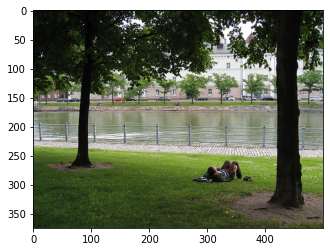

In [88]:
start_token = tokenizer.word_index['<start>']
end_token = tokenizer.word_index['<end>']
# select random image from validation data
rid = np.random.randint(0, len(img_name_val))
image = img_name_val[rid]
print("image",image)
real_caption = ' '.join([tokenizer.index_word[i] for i in cap_val[rid] if i not in [0]])
caption,result,attention_weights = evaluate(image)

first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]

#remove "<unk>" in result
for i in caption:
    if i=="<unk>":
        caption.remove(i)

for i in real_caption:
    if i=="<unk>":
        real_caption.remove(i)

#remove <end> from result         
result_join = ' '.join(caption)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = caption
score = sentence_bleu(reference, candidate, weights=(1.0,0,0,0))
print(f"BLEU-1 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.5,0.5,0,0))
print(f"BLEU-2 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.3,0.3,0.3,0))
print(f"BLEU-3 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.25,0.25,0.25,0.25))
print(f"BLEU-4 score: {score*100}")

print ('Real Caption:', real_caption)
print ('Predicted Caption:', ' '.join(caption))
temp_image = np.array(Image.open(image))
plt.imshow(temp_image)


BLEU-1 score: 5.88235294117647
BLEU-2 score: 3.6178266619513135e-153
BLEU-3 score: 1.0946416849080909e-183
BLEU-4 score: 8.972141065609098e-230
Real Caption: an ice skater is performing an ice skating routine
Predicted Caption: two men are in black leotard is in the sky with both hands up in his hand


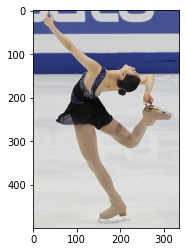

In [89]:
start_token = tokenizer.word_index['<start>']
end_token = tokenizer.word_index['<end>']
# select random image from validation data
rid = np.random.randint(0, len(img_name_val))
image = img_name_val[rid]
real_caption = ' '.join([tokenizer.index_word[i] for i in cap_val[rid] if i not in [0]])
caption,result,attention_weights = evaluate(image)

first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]

#remove "<unk>" in result
for i in caption:
    if i=="<unk>":
        caption.remove(i)

for i in real_caption:
    if i=="<unk>":
        real_caption.remove(i)

#remove <end> from result         
result_join = ' '.join(caption)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = caption
score = sentence_bleu(reference, candidate, weights=(1.0,0,0,0))
print(f"BLEU-1 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.5,0.5,0,0))
print(f"BLEU-2 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.3,0.3,0.3,0))
print(f"BLEU-3 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.25,0.25,0.25,0.25))
print(f"BLEU-4 score: {score*100}")

print ('Real Caption:', real_caption)
print ('Predicted Caption:', ' '.join(caption))
temp_image = np.array(Image.open(image))
plt.imshow(temp_image)


BLEU-1 score: 9.09090909090909
BLEU-2 score: 4.497548684366688e-153
BLEU-3 score: 1.2473514990254889e-183
BLEU-4 score: 1.0003688322288243e-229
Real Caption: man and <unk> in the <unk> snow
Predicted Caption: person skis standing on snow covered landscape under blue cloudy sky


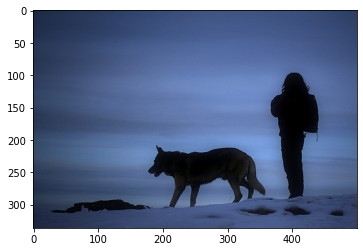

In [90]:
start_token = tokenizer.word_index['<start>']
end_token = tokenizer.word_index['<end>']
# select random image from validation data
rid = np.random.randint(0, len(img_name_val))
image = img_name_val[rid]
real_caption = ' '.join([tokenizer.index_word[i] for i in cap_val[rid] if i not in [0]])
caption,result,attention_weights = evaluate(image)

first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]

#remove "<unk>" in result
for i in caption:
    if i=="<unk>":
        caption.remove(i)

for i in real_caption:
    if i=="<unk>":
        real_caption.remove(i)

#remove <end> from result         
result_join = ' '.join(caption)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = caption
score = sentence_bleu(reference, candidate, weights=(1.0,0,0,0))
print(f"BLEU-1 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.5,0.5,0,0))
print(f"BLEU-2 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.3,0.3,0.3,0))
print(f"BLEU-3 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.25,0.25,0.25,0.25))
print(f"BLEU-4 score: {score*100}")

print ('Real Caption:', real_caption)
print ('Predicted Caption:', ' '.join(caption))
temp_image = np.array(Image.open(image))
plt.imshow(temp_image)


image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/8018915471.jpg
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Real Caption: bmx bike racers head downhill over jump
Predicted Caption: two dirt bikers are standing with their bikes with onlooker


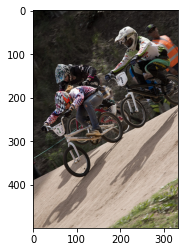

In [91]:
start_token = tokenizer.word_index['<start>']
end_token = tokenizer.word_index['<end>']
# select random image from validation data
rid = np.random.randint(0, len(img_name_val))
image = img_name_val[rid]
real_caption = ' '.join([tokenizer.index_word[i] for i in cap_val[rid] if i not in [0]])
caption,result,attention_weights = evaluate(image)

first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]

#remove "<unk>" in result
for i in caption:
    if i=="<unk>":
        caption.remove(i)

for i in real_caption:
    if i=="<unk>":
        real_caption.remove(i)

#remove <end> from result         
result_join = ' '.join(caption)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = caption
print("image",image)
score = sentence_bleu(reference, candidate, weights=(1.0,0,0,0))
print(f"BLEU-1 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.5,0.5,0,0))
print(f"BLEU-2 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.3,0.3,0.3,0))
print(f"BLEU-3 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.25,0.25,0.25,0.25))
print(f"BLEU-4 score: {score*100}")

print ('Real Caption:', real_caption)
print ('Predicted Caption:', ' '.join(caption))
temp_image = np.array(Image.open(image))
plt.imshow(temp_image)


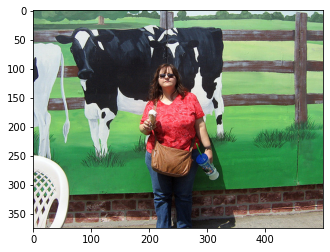

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/259510411.jpg
Real Caption: woman is standing in front of painting of cow
Predicted Caption: woman in red shirt holding children
BLEU-1 score: 20.21768865708778
BLEU-2 score: 5.223533056060786e-153
BLEU-3 score: 1.117179715016979e-183
BLEU-4 score: 8.396161215621529e-230


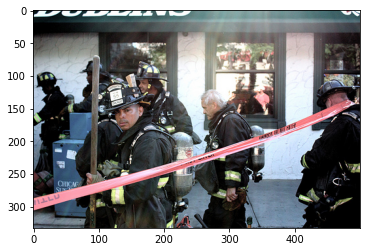

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4719086173.jpg
Real Caption: firefighters in black suits walking in chicago
Predicted Caption: firemen walk in front of people in the united in the camera
BLEU-1 score: 16.666666666666668
BLEU-2 score: 6.08970970641905e-153
BLEU-3 score: 1.4961022763680928e-183
BLEU-4 score: 1.1640469867513693e-229


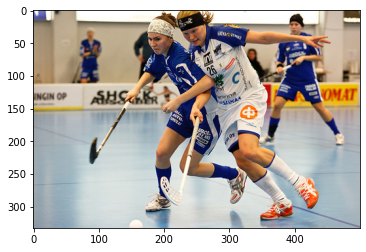

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3234115903.jpg
Real Caption: two girls are fighting for the ball in indoor field hockey
Predicted Caption: two male youth basketball players on opposing teammates
BLEU-1 score: 8.591115984887153
BLEU-2 score: 3.6246559632213337e-153
BLEU-3 score: 9.432335330491414e-184
BLEU-4 score: 7.445183326929417e-230


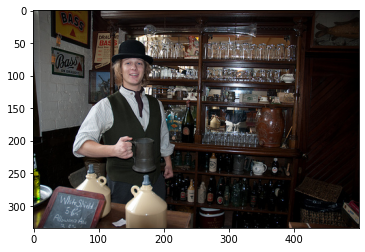

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/7082796649.jpg
Real Caption: an old fashion pub employees are dressed in old fashion wear and alcohol comes in <unk>
Predicted Caption: man looks at on his hand looking at the same time
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


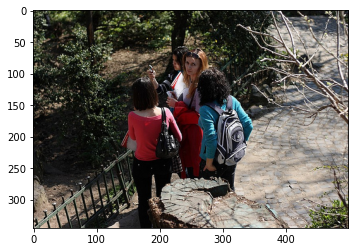

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3423249426.jpg
Real Caption: four women stop along walkway to look at an area beyond the fence
Predicted Caption: three women wearing red backpack standing on rocks
BLEU-1 score: 6.69076785648738
BLEU-2 score: 2.822884902521212e-153
BLEU-3 score: 7.345910141578792e-184
BLEU-4 score: 5.798314605122797e-230


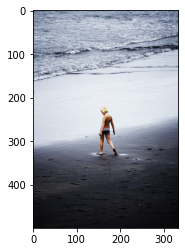

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2744615692.jpg
Real Caption: small child looks at <unk> on the beach
Predicted Caption: young girl walks on beach
BLEU-1 score: 21.952465443761056
BLEU-2 score: 5.177564552024616e-153
BLEU-3 score: 1.0676968639301828e-183
BLEU-4 score: 7.951455490316087e-230


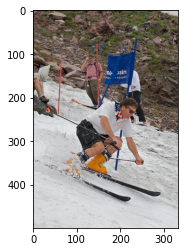

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3698607223.jpg
Real Caption: skiers are competing
Predicted Caption: two children are playing are performing trick
BLEU-1 score: 14.285714285714285
BLEU-2 score: 5.637975647982814e-153
BLEU-3 score: 1.4284901392909564e-183
BLEU-4 score: 1.1200407237786664e-229


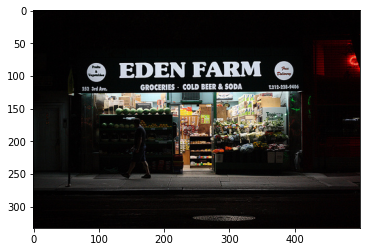

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4914567687.jpg
Real Caption: <unk> farm groceries offers free delivery
Predicted Caption: woman with dark hair exiting from the street with food restaurant
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


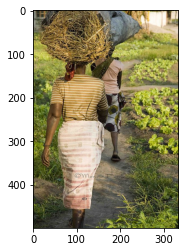

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/1468182643.jpg
Real Caption: women carrying items on their heads walk down dirt path with greenery on each side
Predicted Caption: young girl walking through the park with frisbee
BLEU-1 score: 5.210775245981356
BLEU-2 score: 2.1984649726039663e-153
BLEU-3 score: 5.721000570633737e-184
BLEU-4 score: 4.515731954963997e-230


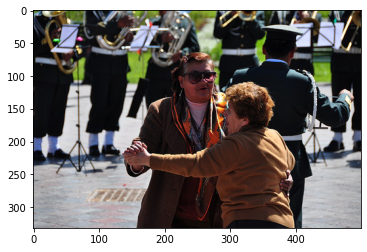

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3826378639.jpg
Real Caption: two older people are dancing to the music of band
Predicted Caption: group of girls in white shirts and standing on
BLEU-1 score: 9.942659075715216
BLEU-2 score: 4.4493443496507245e-153
BLEU-3 score: 1.1854383244313044e-183
BLEU-4 score: 9.412234823955333e-230


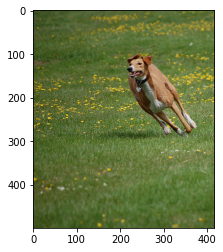

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3597924257.jpg
Real Caption: the brown dog runs through the field
Predicted Caption: dog running in the grass
BLEU-1 score: 26.812801841425575
BLEU-2 score: 6.32389162439519e-153
BLEU-3 score: 1.304087894483289e-183
BLEU-4 score: 9.711929667259894e-230


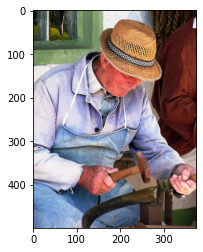

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4303243256.jpg
Real Caption: man wearing straw hat is hammering something
Predicted Caption: an older man reading book with yellow shirt and sweater is looking up while looking up
BLEU-1 score: 12.500000000000004
BLEU-2 score: 5.273843307431706e-153
BLEU-3 score: 1.372396692566494e-183
BLEU-4 score: 1.0832677820940878e-229


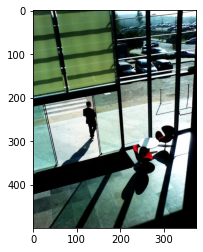

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3281610068.jpg
Real Caption: man is walking through glass
Predicted Caption: woman with white shirt is walking on the rain on top of water
BLEU-1 score: 15.384615384615385
BLEU-2 score: 11.322770341445958
BLEU-3 score: 1.36954071726339e-91
BLEU-4 score: 5.019362538473706e-153


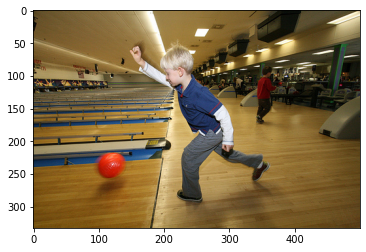

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2228619706.jpg
Real Caption: small boy with is rolling an orange bowling ball down lane
Predicted Caption: young blond boy is bowling with an orange bowling bowl
BLEU-1 score: 54.290245082157575
BLEU-2 score: 33.039990982201786
BLEU-3 score: 26.492636258023083
BLEU-4 score: 3.970716193896693e-76


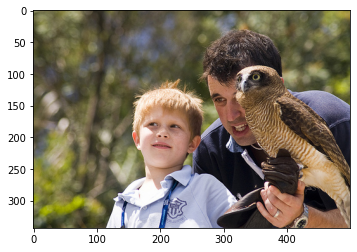

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2620756624.jpg
Real Caption: two men are talking younger and older while the <unk> old owl listens in <unk>
Predicted Caption: woman with glasses and talking on his shoulders
BLEU-1 score: 10.42155049196271
BLEU-2 score: 3.1090989806586375e-153
BLEU-3 score: 7.043377891278847e-184
BLEU-4 score: 5.370140570287953e-230


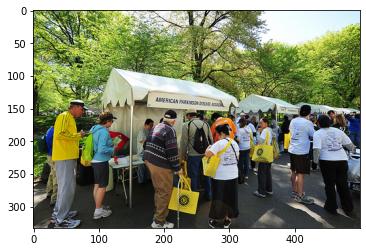

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4548948691.jpg
Real Caption: passersby stop at booth <unk> by the american <unk> <unk> <unk> at fair
Predicted Caption: group of people standing outside holding men in front of city
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


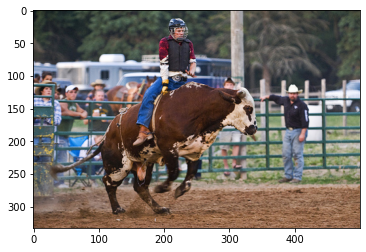

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/571865477.jpg
Real Caption: bull rider in red shirt black vest and jeans rides brown and white bull while onlookers watch from behind green fence
Predicted Caption: man in green and rider while rodeo clown runs up
BLEU-1 score: 16.643554184903977
BLEU-2 score: 3.5110198739973194e-153
BLEU-3 score: 6.924265790126085e-184
BLEU-4 score: 5.099491762132237e-230


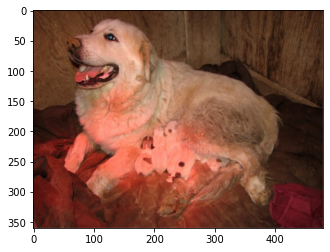

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3551170666.jpg
Real Caption: golden retriever nurses puppies
Predicted Caption: dog bites big orange ball around on her head
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


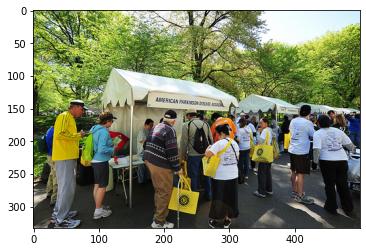

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4548948691.jpg
Real Caption: passersby stop at booth <unk> by the american <unk> <unk> <unk> at fair
Predicted Caption: group of people standing outside holding men in front of city
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


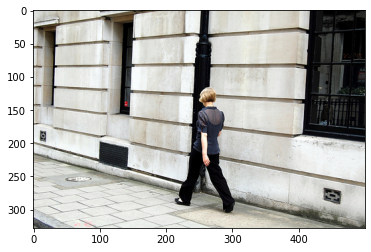

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3821036283.jpg
Real Caption: woman walking down street in black pants
Predicted Caption: man in blue suit is walking by wall with his cellphone
BLEU-1 score: 18.181818181818183
BLEU-2 score: 6.360494346864464e-153
BLEU-3 score: 1.5356698295026469e-183
BLEU-4 score: 1.1896457329133972e-229


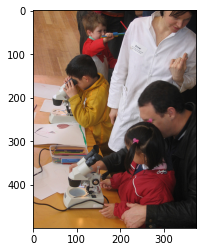

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3036650701.jpg
Real Caption: kids using microscopes with adults watching helping them
Predicted Caption: two guys are wrestling
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


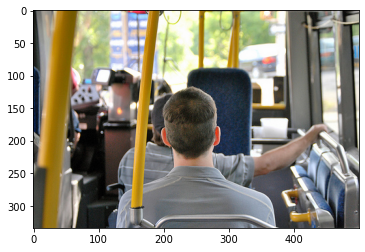

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4628366802.jpg
Real Caption: man with bowl cut and gray shirt photographed from behind on subway
Predicted Caption: woman looks down in the bus
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


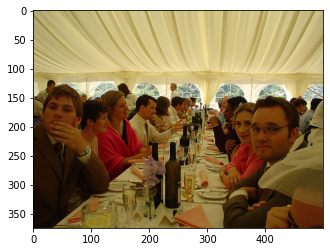

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/209101256.jpg
Real Caption: banquet <unk> are waiting for the meal to be served
Predicted Caption: group of friends sit around large table and have coffee cup
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


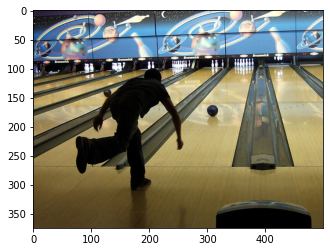

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/1068427675.jpg
Real Caption: guy wearing all black at bowling alley standing in front of lane with black bowling ball in it
Predicted Caption: woman throwing bowling in blue shirt is bowling
BLEU-1 score: 10.743929882257127
BLEU-2 score: 2.6170965635626654e-153
BLEU-3 score: 5.466985685869414e-184
BLEU-4 score: 4.0845859402864615e-230


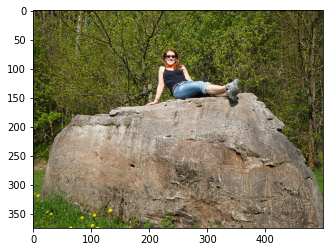

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/5615068475.jpg
Real Caption: woman in dark tank top and <unk> jeans is smiling while sitting on top of large rock or boulder outdoors
Predicted Caption: young boy in blue shirt and jeans is laying down on top of it
BLEU-1 score: 32.57195287655278
BLEU-2 score: 22.128284519616432
BLEU-3 score: 16.17200219770584
BLEU-4 score: 2.4914465040167586e-76


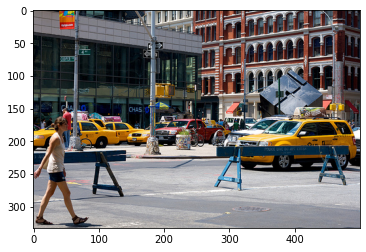

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4831855344.jpg
Real Caption: young woman in shorts and tank top walks down busy modern city street
Predicted Caption: man in hard hat riding an airport
BLEU-1 score: 6.062469223956427
BLEU-2 score: 2.392603769591812e-153
BLEU-3 score: 6.062124254323657e-184
BLEU-4 score: 4.753148692240233e-230


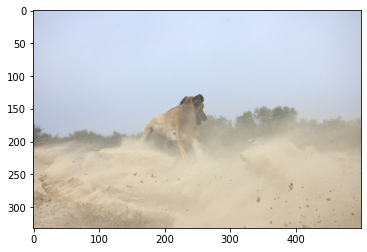

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/1541272333.jpg
Real Caption: dog and dust storm
Predicted Caption: two dogs running in the snow
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


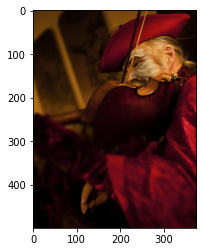

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/5526795355.jpg
Real Caption: man with mustache face paint and matching red hat and shirt is playing the violin
Predicted Caption: young girl wearing red bikini holding black hoop
BLEU-1 score: 5.210775245981356
BLEU-2 score: 2.1984649726039663e-153
BLEU-3 score: 5.721000570633737e-184
BLEU-4 score: 4.515731954963997e-230


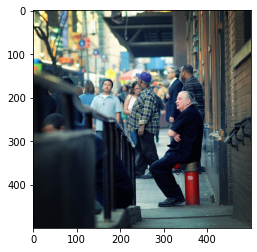

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4653019748.jpg
Real Caption: older man in black shirt sitting on fire hydrant
Predicted Caption: woman in green and yellow shirt and the city sidewalk in front of brightly lit food stand that is outside on street
BLEU-1 score: 13.636363636363635
BLEU-2 score: 5.508349685012077e-153
BLEU-3 score: 1.4086925928619167e-183
BLEU-4 score: 1.1070900996592687e-229


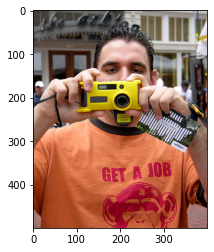

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/134201079.jpg
Real Caption: person holding yellow camera
Predicted Caption: man hands are preparing to be at the camera during his face and his mouth
BLEU-1 score: 6.666666666666667
BLEU-2 score: 3.851470592303926e-153
BLEU-3 score: 1.1365257532669032e-183
BLEU-4 score: 9.25732495472854e-230


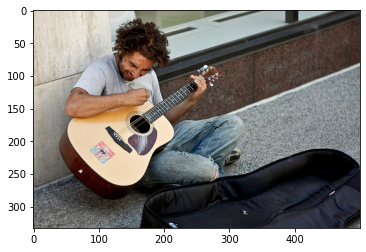

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4760372043.jpg
Real Caption: man in gray shirt sitting on ground playing guitar
Predicted Caption: man plays his guitar in an electric guitar
BLEU-1 score: 33.09363384692233
BLEU-2 score: 8.061224930331203e-153
BLEU-3 score: 1.683950142240867e-183
BLEU-4 score: 1.258141043412406e-229


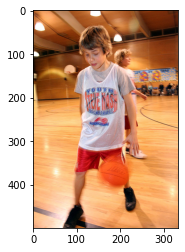

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2021613437.jpg
Real Caption: boy dribbles basketball in the gymnasium
Predicted Caption: young blond boy dribbles his basketball
BLEU-1 score: 50.0
BLEU-2 score: 31.6227766016838
BLEU-3 score: 2.536315813271983e-91
BLEU-4 score: 8.38826642100846e-153


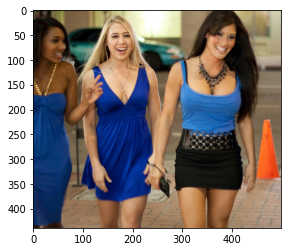

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4467525810.jpg
Real Caption: three women in short dresses walk together laughing and smiling
Predicted Caption: two ladies in sunglasses are waiting for picture
BLEU-1 score: 9.735009788392563
BLEU-2 score: 4.1072732976237013e-153
BLEU-3 score: 1.0688236188553917e-183
BLEU-4 score: 8.436497969708995e-230


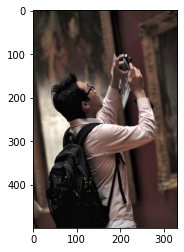

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/5788742746.jpg
Real Caption: asian man wearing black backpack takes pictures of framed artwork
Predicted Caption: man and woman wearing gray hair to be going to her head
BLEU-1 score: 16.666666666666668
BLEU-2 score: 6.08970970641905e-153
BLEU-3 score: 1.4961022763680928e-183
BLEU-4 score: 1.1640469867513693e-229


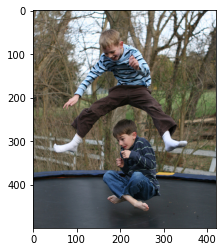

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2373234213.jpg
Real Caption: one boy jumps over another boy on trampoline
Predicted Caption: boy in yellow shirt is playing on the air while another boy in yellow surface with yellow outfit is skateboard
BLEU-1 score: 20.0
BLEU-2 score: 10.259783520851542
BLEU-3 score: 1.2908811165383826e-91
BLEU-4 score: 4.777946850498661e-153


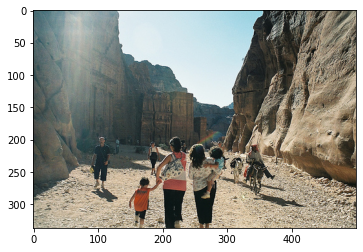

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2917527717.jpg
Real Caption: group of people are walking in canyon
Predicted Caption: three young children look at the road
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


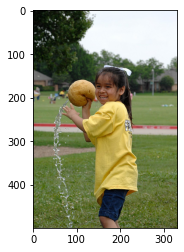

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3534548254.jpg
Real Caption: girl with bowing throwing wet sponge
Predicted Caption: little boy carries soccer ball on string
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


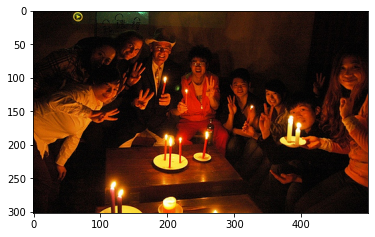

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/6894721598.jpg
Real Caption: group of asians are gathered around lit candles celebrating
Predicted Caption: group of people in dark room holding candles and making the hand gesture three
BLEU-1 score: 21.428571428571423
BLEU-2 score: 12.838814775327384
BLEU-3 score: 1.47678845808219e-91
BLEU-4 score: 5.344839673067705e-153


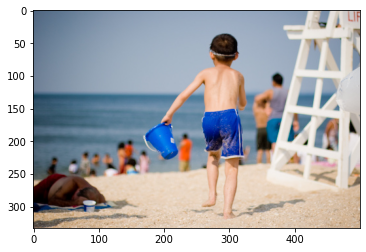

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/823675317.jpg
Real Caption: child walks on the beach with bucket
Predicted Caption: child wearing red shirt plays with the beach with one another
BLEU-1 score: 36.36363636363637
BLEU-2 score: 26.967994498529684
BLEU-3 score: 23.563317641070423
BLEU-4 score: 3.661843723291765e-76


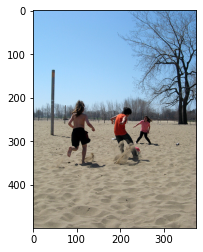

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2555638166.jpg
Real Caption: three people playing with red ball in large sandy area with tree in the background
Predicted Caption: group of people playing game of water
BLEU-1 score: 9.111615923542011
BLEU-2 score: 6.95911161216604
BLEU-3 score: 6.474421808325025e-92
BLEU-4 score: 2.2221882212363203e-153


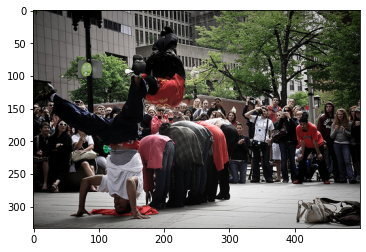

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3545976616.jpg
Real Caption: men performing in front of crowd
Predicted Caption: group of girls in front of building
BLEU-1 score: 42.857142857142854
BLEU-2 score: 37.79644730092272
BLEU-3 score: 34.41752104927812
BLEU-4 score: 5.021333847570327e-76


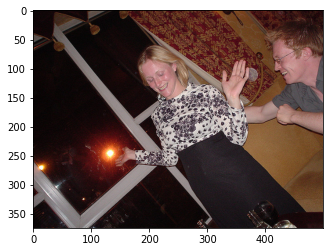

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/197976461.jpg
Real Caption: woman in blouse and skirt enjoys dancing with male friend
Predicted Caption: young girl is painting an arcade game
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


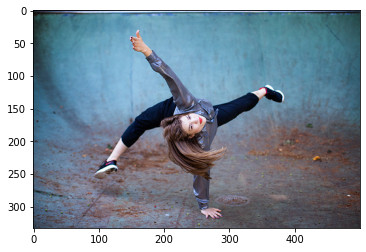

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/7796487260.jpg
Real Caption: young woman does an acrobatic move on one hand in an empty pool
Predicted Caption: boy in black shirt is jumping outdoors in the air on the air
BLEU-1 score: 15.384615384615385
BLEU-2 score: 5.850803834986753e-153
BLEU-3 score: 1.4606045589277217e-183
BLEU-4 score: 1.1409851298103346e-229


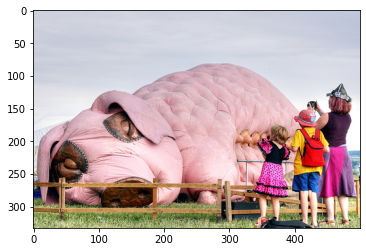

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3670681503.jpg
Real Caption: people taking pictures of giant pig behind wooden fence
Predicted Caption: three women in blue shirt is raising his back of them under large tree in the background
BLEU-1 score: 5.88235294117647
BLEU-2 score: 3.6178266619513135e-153
BLEU-3 score: 1.0946416849080909e-183
BLEU-4 score: 8.972141065609098e-230


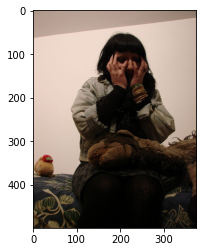

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/1817746886.jpg
Real Caption: woman holding her face while sitting down
Predicted Caption: woman sits on bed and sunglasses is seated on her face
BLEU-1 score: 27.27272727272727
BLEU-2 score: 16.514456476895408
BLEU-3 score: 1.7175994813661398e-91
BLEU-4 score: 6.061838450024688e-153


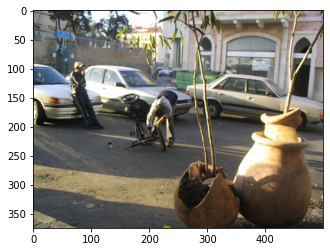

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/416933689.jpg
Real Caption: two guys outside looks like in parking lot one guy is picking up bike
Predicted Caption: man in blue shirt sitting on green wheelbarrow
BLEU-1 score: 5.904581909262685
BLEU-2 score: 2.4911871828277866e-153
BLEU-3 score: 6.48274294660805e-184
BLEU-4 score: 5.116994679231889e-230


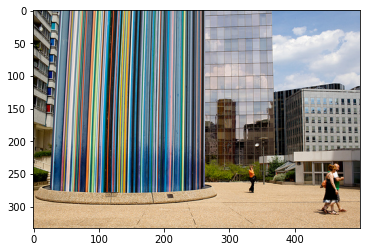

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4671295213.jpg
Real Caption: there is tall rainbow striped structure in front of tall building
Predicted Caption: woman in an umbrella is walking in front of brick building
BLEU-1 score: 45.45454545454545
BLEU-2 score: 30.15113445777636
BLEU-3 score: 25.19471451241524
BLEU-4 score: 3.8719283242189534e-76


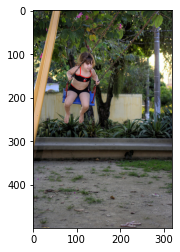

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2979914158.jpg
Real Caption: the little girl wearing black swimsuit is playing on swing
Predicted Caption: little boy in toy car is riding stationary rings outside
BLEU-1 score: 20.0
BLEU-2 score: 6.6709427497276e-153
BLEU-3 score: 1.5802130991274055e-183
BLEU-4 score: 1.2183324802375697e-229


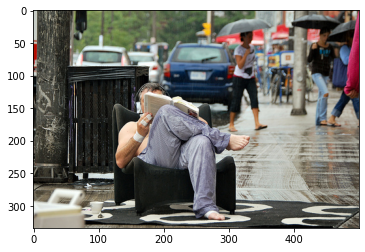

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4915029510.jpg
Real Caption: shirtless man is sitting on chair on the sidewalk reading book
Predicted Caption: man and woman wearing white shirt and hat is sitting on the street
BLEU-1 score: 38.46153846153847
BLEU-2 score: 31.008683647302114
BLEU-3 score: 24.1252705653061
BLEU-4 score: 3.734475389420366e-76


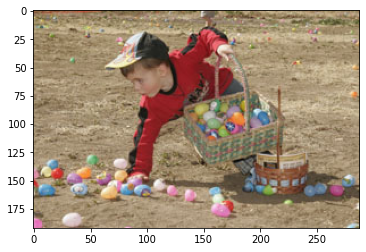

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/6905008788.jpg
Real Caption: young boy in red and black shirt is happily picking up easter eggs and placing them into his basket
Predicted Caption: little boy is cutting the park with rocky plays in the park
BLEU-1 score: 13.950878644251178
BLEU-2 score: 4.162016257138036e-153
BLEU-3 score: 9.428665176320345e-184
BLEU-4 score: 7.188774785137329e-230


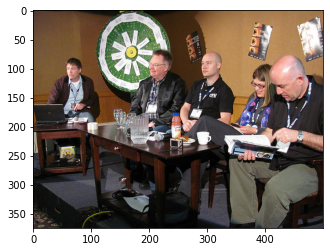

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4688320491.jpg
Real Caption: five people wearing <unk> are sitting in front of green and white wheel inside room
Predicted Caption: group of people are standing around pulled together on table in white stick at bowling alley
BLEU-1 score: 31.25
BLEU-2 score: 8.338678437159848e-153
BLEU-3 score: 1.8065985833817734e-183
BLEU-4 score: 1.362137122503591e-229


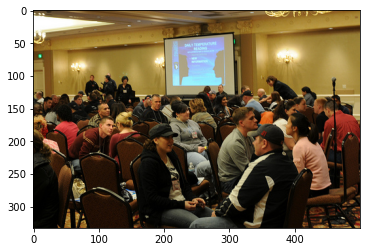

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4367617589.jpg
Real Caption: group of about people in hotel meeting room
Predicted Caption: group of people are gathered to each other businessmen
BLEU-1 score: 33.33333333333333
BLEU-2 score: 20.412414523193153
BLEU-3 score: 1.9504730631920925e-91
BLEU-4 score: 6.7393716283177e-153


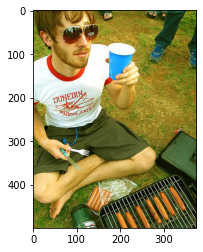

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/10160966.jpg
Real Caption: guy in shorts and white sits on the ground in front of grill with hotdogs on it
Predicted Caption: little girl wearing red shirt and white striped and flipping
BLEU-1 score: 9.93170607582819
BLEU-2 score: 7.402656639366505
BLEU-3 score: 8.021090898057843e-92
BLEU-4 score: 2.8599796959902467e-153


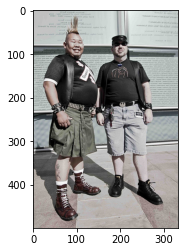

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4470861434.jpg
Real Caption: two large men are dressed in black khaki bottoms boots and jewelry with <unk>
Predicted Caption: two men in clothing stand in front of wall
BLEU-1 score: 19.12511402458109
BLEU-2 score: 4.941250555528194e-153
BLEU-3 score: 1.056806729890873e-183
BLEU-4 score: 7.942428204384923e-230


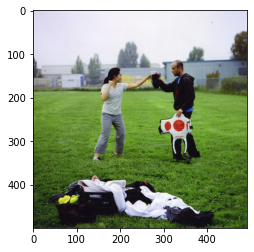

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2913154802.jpg
Real Caption: girl and guy in the middle of field practice exercises
Predicted Caption: three children playing with the grass
BLEU-1 score: 8.556951983876534
BLEU-2 score: 3.126561213214481e-153
BLEU-3 score: 7.68124520511009e-184
BLEU-4 score: 5.9764165035645785e-230


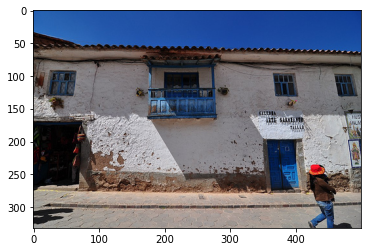

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3827171692.jpg
Real Caption: person in brown jacket and red hat are walking by an adobe house with blue door
Predicted Caption: man in blue jeans and red shoes is approaching the side street
BLEU-1 score: 23.88437701912631
BLEU-2 score: 12.473209096354934
BLEU-3 score: 1.2702357167567957e-91
BLEU-4 score: 4.4594254026474683e-153


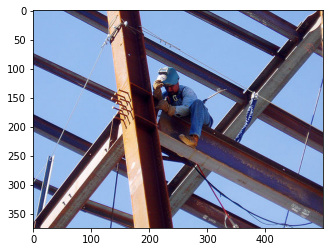

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/38137970.jpg
Real Caption: man in blue welder helmet shirt and jeans is welding the <unk> of building on reddish beam
Predicted Caption: man on scaffolding working on large glass building
BLEU-1 score: 12.174467525938116
BLEU-2 score: 2.9655589225275415e-153
BLEU-3 score: 6.19490637288141e-184
BLEU-4 score: 4.628442239654113e-230


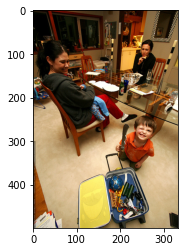

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/440481388.jpg
Real Caption: two women are sitting at table one is holding baby and another child is playing on the floor
Predicted Caption: young boy is jumping on the floor
BLEU-1 score: 11.87132497963433
BLEU-2 score: 9.066874219765737
BLEU-3 score: 7.794682869514748
BLEU-4 score: 1.1209623436547131e-76


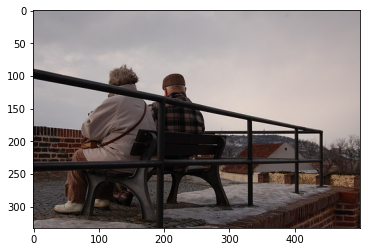

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4471667766.jpg
Real Caption: couple of older people are sitting on chair in an area surrounded by railing
Predicted Caption: man wearing sunglasses is sitting on wooden rail near two people out from the other reads newspaper in
BLEU-1 score: 22.22222222222222
BLEU-2 score: 11.433239009500591
BLEU-3 score: 1.3775421583057705e-91
BLEU-4 score: 5.043788381574437e-153


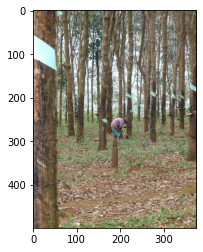

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/5249558588.jpg
Real Caption: man standing in the forrest marking trees to be ready to be cut down
Predicted Caption: person walking through the world like he walks in front of trees with two paved between two green grass
BLEU-1 score: 15.789473684210522
BLEU-2 score: 5.927288177094464e-153
BLEU-3 score: 1.4720309963537117e-183
BLEU-4 score: 1.1484186507842884e-229


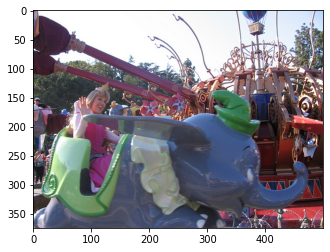

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3455964125.jpg
Real Caption: woman is waving to the crowd as she rides roller coaster
Predicted Caption: <unk> group of the crowd who is wearing blue and gold drum
BLEU-1 score: 25.0
BLEU-2 score: 15.075567228888179
BLEU-3 score: 1.6261759223357467e-91
BLEU-4 score: 5.791739854583281e-153


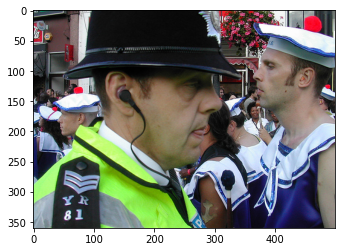

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/227689211.jpg
Real Caption: policeman wearing an <unk> at parade
Predicted Caption: man in uniform wears white crane
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


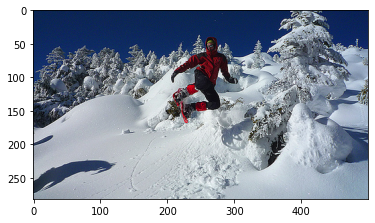

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4304622669.jpg
Real Caption: man snowboarding in the mountains
Predicted Caption: group of people jump in midair
BLEU-1 score: 16.666666666666668
BLEU-2 score: 6.08970970641905e-153
BLEU-3 score: 1.4961022763680928e-183
BLEU-4 score: 1.1640469867513693e-229


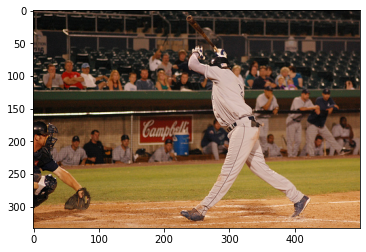

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3726130458.jpg
Real Caption: baseball player runs to catch the ball
Predicted Caption: baseball player in white uniform is dribbling the ball
BLEU-1 score: 44.44444444444444
BLEU-2 score: 33.333333333333336
BLEU-3 score: 2.617764516460675e-91
BLEU-4 score: 8.612150057732662e-153


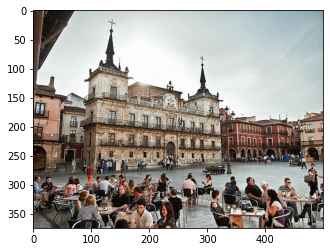

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4663418784.jpg
Real Caption: people are sitting around tables in city square
Predicted Caption: large group is performing in front of throwing
BLEU-1 score: 12.500000000000004
BLEU-2 score: 5.273843307431706e-153
BLEU-3 score: 1.372396692566494e-183
BLEU-4 score: 1.0832677820940878e-229


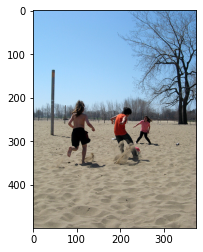

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2555638166.jpg
Real Caption: three people playing with red ball in large sandy area with tree in the background
Predicted Caption: group of people playing game of water
BLEU-1 score: 9.111615923542011
BLEU-2 score: 6.95911161216604
BLEU-3 score: 6.474421808325025e-92
BLEU-4 score: 2.2221882212363203e-153


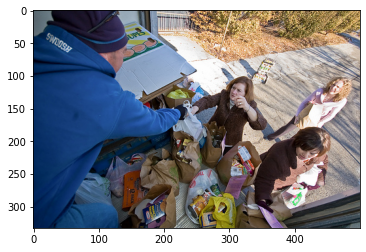

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3084752813.jpg
Real Caption: man in blue beanie and blue sweater is handing woman in brown jacket plastic bag
Predicted Caption: man in red shirt is laughing
BLEU-1 score: 11.156508007421492
BLEU-2 score: 7.055995207471725
BLEU-3 score: 5.6592855360237266e-92
BLEU-4 score: 1.8716752298873142e-153


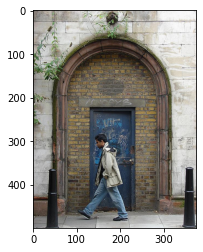

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2924096614.jpg
Real Caption: man in white jacket and blue jeans stands in front of blue door decorated with graffiti
Predicted Caption: woman in traditional orthodox jewish dress is seen alone from behind
BLEU-1 score: 5.770331081275289
BLEU-2 score: 2.854757945924487e-153
BLEU-3 score: 7.917394236512313e-184
BLEU-4 score: 6.3497053018839555e-230


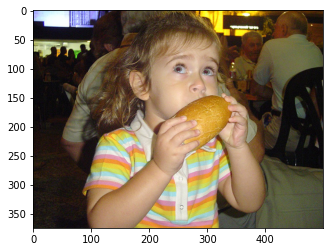

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/1459032057.jpg
Real Caption: the little girl in the striped shirt is eating some bread
Predicted Caption: woman with dark hair wearing pink shirt is holding her stove
BLEU-1 score: 18.181818181818183
BLEU-2 score: 13.483997249264846
BLEU-3 score: 1.5208785072510163e-91
BLEU-4 score: 5.477489369001354e-153


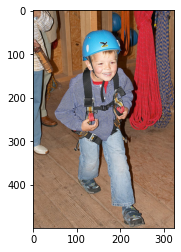

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/499732144.jpg
Real Caption: young smiling boy wearing harness and helmet
Predicted Caption: child wearing blue shirt is
BLEU-1 score: 13.406400920712787
BLEU-2 score: 4.471666651098519e-153
BLEU-3 score: 1.0592485173532028e-183
BLEU-4 score: 8.166726842395623e-230


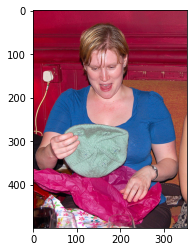

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2315320158.jpg
Real Caption: woman in blue shirt unwraps gift of green hat
Predicted Caption: woman sits on science chest
BLEU-1 score: 8.986579282344431
BLEU-2 score: 2.997447795420392e-153
BLEU-3 score: 7.100355149153815e-184
BLEU-4 score: 5.474320712955125e-230


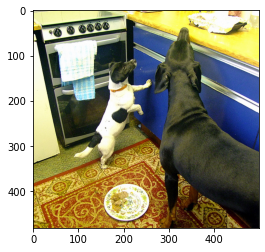

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3204525212.jpg
Real Caption: the dogs are begging at the kitchen counter
Predicted Caption: woman dressed in kitchen while eating with wooden spoon
BLEU-1 score: 11.111111111111109
BLEU-2 score: 4.972227154133551e-153
BLEU-3 score: 1.3247499323693867e-183
BLEU-4 score: 1.0518351895246306e-229


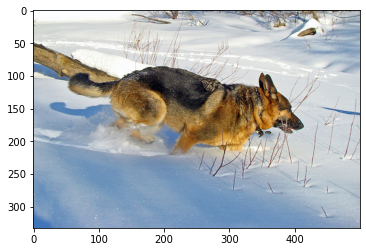

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3251460982.jpg
Real Caption: dog runs through deep snow that has covered the grass
Predicted Caption: two dogs running in the snow
BLEU-1 score: 17.113903967753068
BLEU-2 score: 4.421625271317475e-153
BLEU-3 score: 9.45672212180377e-184
BLEU-4 score: 7.107197028258988e-230


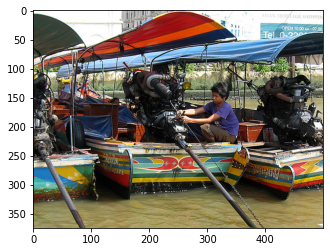

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/363394643.jpg
Real Caption: person with purple shirt making adjustments to the motor on boat
Predicted Caption: man is standing around man and white bikes
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


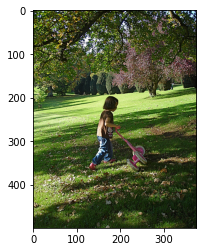

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2936693681.jpg
Real Caption: girl is in field surrounded by trees and pushing pink scooter on the grass
Predicted Caption: child is crying in the grass playing with smiling for the air
BLEU-1 score: 28.2160574963538
BLEU-2 score: 14.735355447829393
BLEU-3 score: 1.5006061907844977e-91
BLEU-4 score: 5.268188634815163e-153


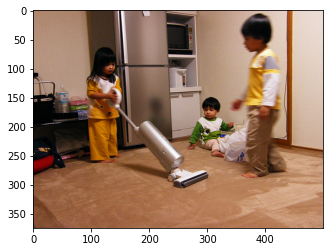

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3097037008.jpg
Real Caption: little girl plays with vacuum as other children look on
Predicted Caption: young girl vacuuming while two boys watch her
BLEU-1 score: 9.735009788392563
BLEU-2 score: 4.1072732976237013e-153
BLEU-3 score: 1.0688236188553917e-183
BLEU-4 score: 8.436497969708995e-230


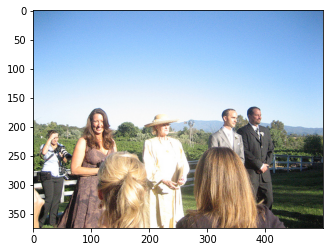

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/226664962.jpg
Real Caption: people are dressed formally there is photographer
Predicted Caption: group of people walking at an open school
BLEU-1 score: 12.500000000000004
BLEU-2 score: 5.273843307431706e-153
BLEU-3 score: 1.372396692566494e-183
BLEU-4 score: 1.0832677820940878e-229


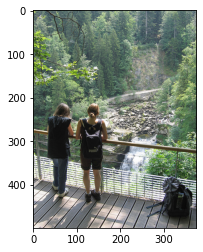

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2309682355.jpg
Real Caption: two females one wearing backpack are standing over body of water
Predicted Caption: two ladies walking by wall in front of wall in bicycle side of beautiful white bag
BLEU-1 score: 12.500000000000004
BLEU-2 score: 5.273843307431706e-153
BLEU-3 score: 1.372396692566494e-183
BLEU-4 score: 1.0832677820940878e-229


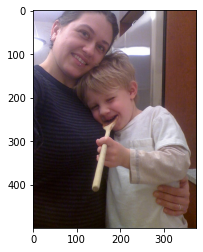

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2415587549.jpg
Real Caption: mother and child are baking
Predicted Caption: woman with glasses and holding on the girl
BLEU-1 score: 12.500000000000004
BLEU-2 score: 5.273843307431706e-153
BLEU-3 score: 1.372396692566494e-183
BLEU-4 score: 1.0832677820940878e-229


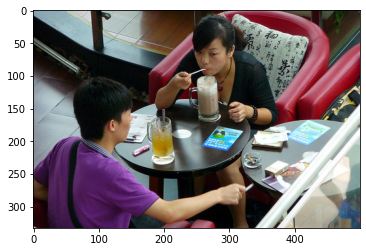

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4985753773.jpg
Real Caption: students having break after taking <unk> <unk> in their school main hall
Predicted Caption: woman with glasses and woman are looking at the food
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


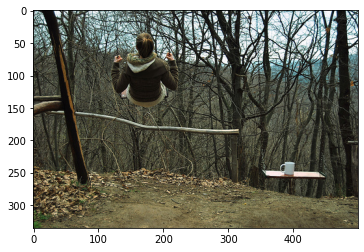

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3357999648.jpg
Real Caption: young lady is swinging facing the woods overlooking valley
Predicted Caption: woman in field enjoys her leg in beautiful
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


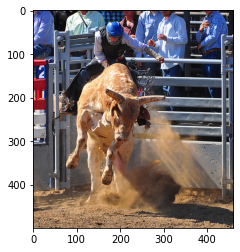

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/6960814190.jpg
Real Caption: the cowboy holds on to the bull who is desperately trying to throw him off
Predicted Caption: two men are walking on the ground off of by two other people
BLEU-1 score: 19.786244288317878
BLEU-2 score: 6.14393526627715e-153
BLEU-3 score: 1.4143128716191827e-183
BLEU-4 score: 1.0826504568327566e-229


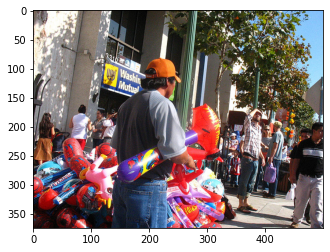

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/1796521614.jpg
Real Caption: man wearing gray and black shirt and blue jeans sells inflatable brightly colored toys
Predicted Caption: man in orange talking to make balloon animal for little girl in the street
BLEU-1 score: 7.1428571428571415
BLEU-2 score: 3.986650812853149e-153
BLEU-3 score: 1.1602945388103906e-183
BLEU-4 score: 9.418382295637229e-230


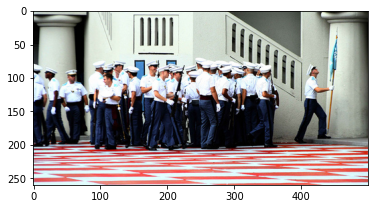

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/47136694.jpg
Real Caption: individuals in military attire congregate beneath stairwell
Predicted Caption: group of people in front of an asian building
BLEU-1 score: 11.111111111111109
BLEU-2 score: 4.972227154133551e-153
BLEU-3 score: 1.3247499323693867e-183
BLEU-4 score: 1.0518351895246306e-229


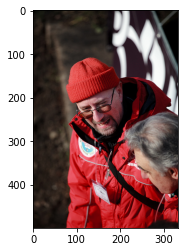

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3225880532.jpg
Real Caption: two men talk outdoors
Predicted Caption: child wearing red shirt is holding onto the outdoors
BLEU-1 score: 11.111111111111109
BLEU-2 score: 4.972227154133551e-153
BLEU-3 score: 1.3247499323693867e-183
BLEU-4 score: 1.0518351895246306e-229


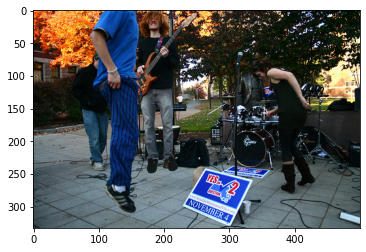

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2999735171.jpg
Real Caption: several people in band jumping up and down to the music
Predicted Caption: man and woman stands along city street for little girl in front of people walking past off the background
BLEU-1 score: 21.052631578947366
BLEU-2 score: 6.844242849220165e-153
BLEU-3 score: 1.6047174526562592e-183
BLEU-4 score: 1.2340561512781763e-229


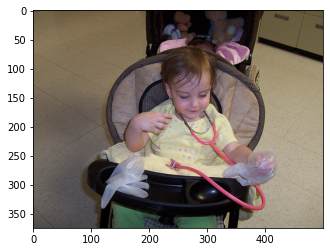

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/288406480.jpg
Real Caption: one child sitting in stroller wearing stethoscope
Predicted Caption: small child with bucket as he holds guitar like instrument
BLEU-1 score: 10.000000000000002
BLEU-2 score: 4.717068855239749e-153
BLEU-3 score: 1.2835318765197404e-183
BLEU-4 score: 1.0244914152188952e-229


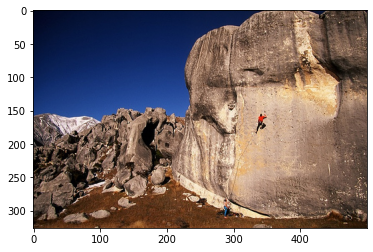

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/405534993.jpg
Real Caption: two men climb large rock
Predicted Caption: man in white shirt is laying down tall cliff
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


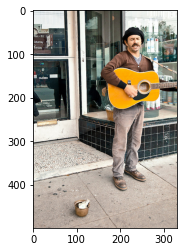

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4833879670.jpg
Real Caption: man with mustache and guitar sings for tips on the street
Predicted Caption: woman wearing blue plays with on the street
BLEU-1 score: 34.364463939548614
BLEU-2 score: 25.977093006312163
BLEU-3 score: 22.39570726416524
BLEU-4 score: 3.297337141451012e-76


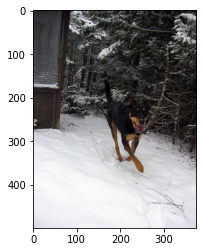

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/445655284.jpg
Real Caption: the black and brown dog is running through the snow
Predicted Caption: this person is walking on the snow
BLEU-1 score: 27.91881675133095
BLEU-2 score: 17.410441154600917
BLEU-3 score: 1.493615157227752e-91
BLEU-4 score: 5.023587836914362e-153


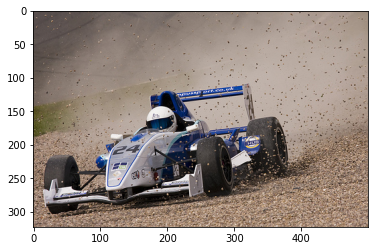

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3559374748.jpg
Real Caption: person is in race car on track with lot <unk>
Predicted Caption: person rides his toy car on dirt bike
BLEU-1 score: 29.20502936517768
BLEU-2 score: 18.02573546715273
BLEU-3 score: 1.6379840831661966e-91
BLEU-4 score: 5.588971591971542e-153


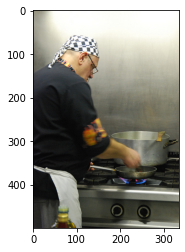

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4426158851.jpg
Real Caption: man adjusts some materials in pan
Predicted Caption: man is preparing to the stove in pot of the food on each other hand
BLEU-1 score: 13.333333333333334
BLEU-2 score: 5.4468019467172e-153
BLEU-3 score: 1.3992273317570998e-183
BLEU-4 score: 1.1008876702055895e-229


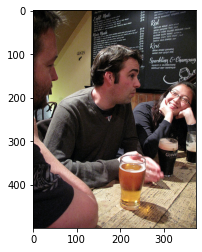

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3023485450.jpg
Real Caption: few young people out drinking
Predicted Caption: smiling man is cutting up some food
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


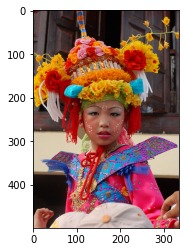

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2420546021.jpg
Real Caption: young woman with colorful clothes on
Predicted Caption: woman in red shirt and red coat stands in her fruit
BLEU-1 score: 9.09090909090909
BLEU-2 score: 4.497548684366688e-153
BLEU-3 score: 1.2473514990254889e-183
BLEU-4 score: 1.0003688322288243e-229


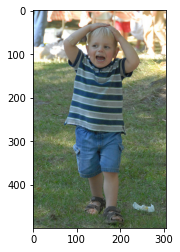

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/1363924449.jpg
Real Caption: boy holds his hands on his head
Predicted Caption: little boy stands on guard
BLEU-1 score: 26.812801841425575
BLEU-2 score: 6.32389162439519e-153
BLEU-3 score: 1.304087894483289e-183
BLEU-4 score: 9.711929667259894e-230


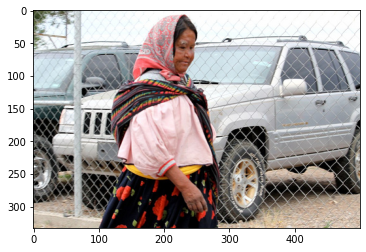

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4795096132.jpg
Real Caption: an old woman walking down the street
Predicted Caption: woman with scarf on is by fence with vehicles on the other side of the fence
BLEU-1 score: 12.500000000000004
BLEU-2 score: 5.273843307431706e-153
BLEU-3 score: 1.372396692566494e-183
BLEU-4 score: 1.0832677820940878e-229


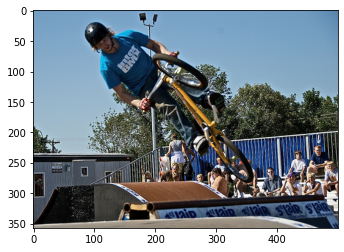

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2813992915.jpg
Real Caption: man rides yellow bike over ramp while others watch
Predicted Caption: man on bicycle rides motorcycle
BLEU-1 score: 17.973158564688863
BLEU-2 score: 4.239031324788977e-153
BLEU-3 score: 8.741562574645582e-184
BLEU-4 score: 6.510101141652544e-230


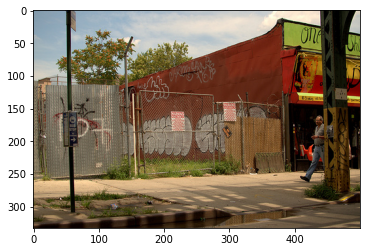

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4835932220.jpg
Real Caption: photo of gated lot next to store graffiti on the side of the store
Predicted Caption: woman with white shirt standing on the street sidewalk
BLEU-1 score: 12.750076016387393
BLEU-2 score: 9.562557012290547
BLEU-3 score: 9.909183413243782e-92
BLEU-4 score: 3.4939917753558776e-153


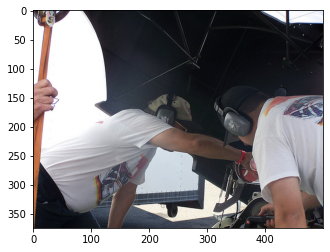

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3721604285.jpg
Real Caption: men wearing hearing safety equipment are examining something
Predicted Caption: man in red shirt is preparing food
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


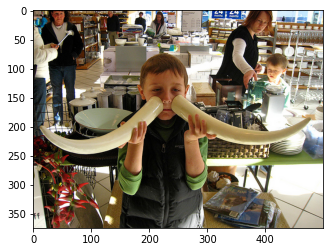

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2663272259.jpg
Real Caption: boy in green shirt and black vest holds elephant <unk> to his face
Predicted Caption: woman with red shirt is playing the of people in the camera
BLEU-1 score: 15.33407357715539
BLEU-2 score: 5.602803402104823e-153
BLEU-3 score: 1.3764805430866801e-183
BLEU-4 score: 1.0709749285266912e-229


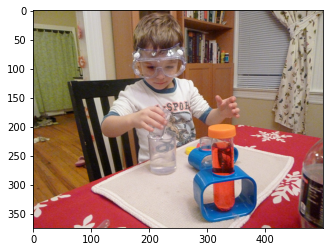

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/5291335711.jpg
Real Caption: the little boy with the brown hair and big glasses is in his kitchen trying his <unk> at science
Predicted Caption: young boy is looking at an orange life jacket is cutting paper with food item
BLEU-1 score: 20.424755689723963
BLEU-2 score: 5.899900942047322e-153
BLEU-3 score: 1.3194271509875563e-183
BLEU-4 score: 1.0027407046471032e-229


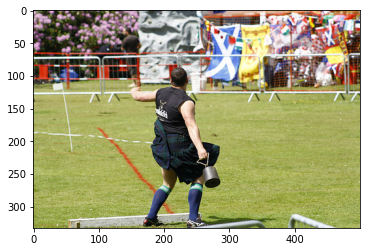

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4696008531.jpg
Real Caption: man is wearing blue socks and kilt
Predicted Caption: man in blue shirt and black chair to catch frisbee
BLEU-1 score: 30.0
BLEU-2 score: 8.170202920075766e-153
BLEU-3 score: 1.7846088208682726e-183
BLEU-4 score: 1.3483065280626045e-229


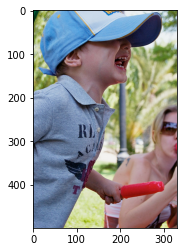

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4440605249.jpg
Real Caption: this small boy is eating color ice creme in the stick
Predicted Caption: girl with beard and glasses is smiling and red hat
BLEU-1 score: 9.048374180359598
BLEU-2 score: 4.2681804036729734e-153
BLEU-3 score: 1.1613876691169721e-183
BLEU-4 score: 9.269981669466711e-230


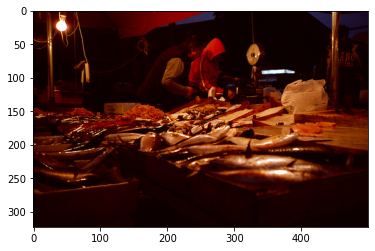

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4027325112.jpg
Real Caption: dark image of two people inside fish market
Predicted Caption: group of people protesting with food outdoors
BLEU-1 score: 24.767939992862335
BLEU-2 score: 6.911878967366998e-153
BLEU-3 score: 1.5245587914760605e-183
BLEU-4 score: 1.154647032204335e-229


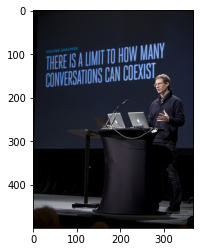

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4039941514.jpg
Real Caption: man gives speech and uses to apple computers
Predicted Caption: man in black dress and black vest holding microphone
BLEU-1 score: 22.22222222222222
BLEU-2 score: 7.031791076575252e-153
BLEU-3 score: 1.6309584783156365e-183
BLEU-4 score: 1.2508498911928378e-229


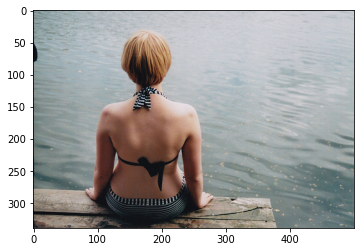

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4937201263.jpg
Real Caption: woman in bathing suit is sitting on dock over body of water
Predicted Caption: woman is cleaning fish on the water
BLEU-1 score: 27.973809117540178
BLEU-2 score: 5.5200479105104e-153
BLEU-3 score: 1.0599488305297578e-183
BLEU-4 score: 7.754226225491551e-230


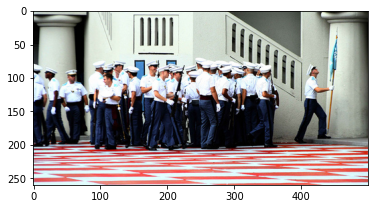

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/47136694.jpg
Real Caption: individuals in military attire congregate beneath stairwell
Predicted Caption: group of people in front of an asian building
BLEU-1 score: 11.111111111111109
BLEU-2 score: 4.972227154133551e-153
BLEU-3 score: 1.3247499323693867e-183
BLEU-4 score: 1.0518351895246306e-229


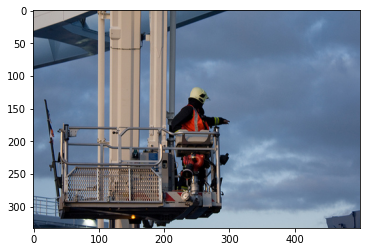

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3952819160.jpg
Real Caption: man in some sort of lift pointing to perhaps another worker
Predicted Caption: man wearing hard hat is cutting rusty girder
BLEU-1 score: 8.591115984887153
BLEU-2 score: 3.6246559632213337e-153
BLEU-3 score: 9.432335330491414e-184
BLEU-4 score: 7.445183326929417e-230


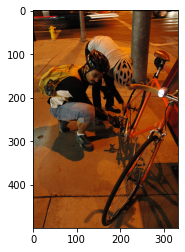

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/288908971.jpg
Real Caption: two men cyclists examining the chain on bike at night
Predicted Caption: man in green and blue shirt is jumping onto the background
BLEU-1 score: 9.09090909090909
BLEU-2 score: 4.497548684366688e-153
BLEU-3 score: 1.2473514990254889e-183
BLEU-4 score: 1.0003688322288243e-229


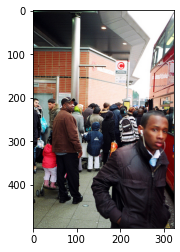

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3354463693.jpg
Real Caption: group of people on crowded sidewalk boarding bus
Predicted Caption: people are waiting on crowded place
BLEU-1 score: 35.826565528689464
BLEU-2 score: 22.65870956238665
BLEU-3 score: 1.8173496937128004e-91
BLEU-4 score: 6.0104555320873e-153


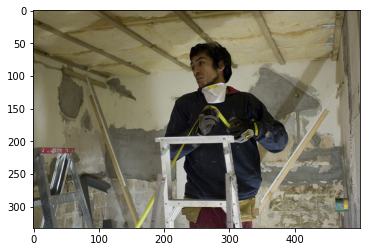

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2456675104.jpg
Real Caption: man stands on ladder while in construction zone
Predicted Caption: man wearing blue workman is cutting meat
BLEU-1 score: 12.383969996431167
BLEU-2 score: 4.887436488566011e-153
BLEU-3 score: 1.2383265317623888e-183
BLEU-4 score: 9.709385502639236e-230


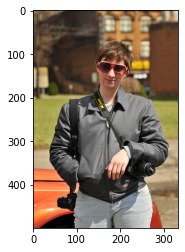

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3396251819.jpg
Real Caption: woman wearing gray jacket and pink sunglasses
Predicted Caption: man wearing red shirt is wearing blue tank top and yellow bag and his left arm
BLEU-1 score: 12.500000000000004
BLEU-2 score: 5.273843307431706e-153
BLEU-3 score: 1.372396692566494e-183
BLEU-4 score: 1.0832677820940878e-229


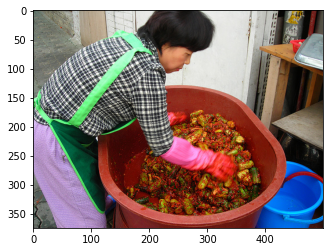

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/275162158.jpg
Real Caption: an older asian person mixes vegetables in large <unk>
Predicted Caption: child looking over to keep the red and flipping
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


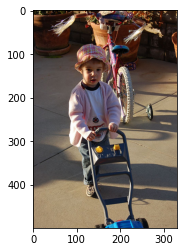

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/298611438.jpg
Real Caption: little girl pushing her toy lawn mower
Predicted Caption: man in helmet and blue shirt is riding bike
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


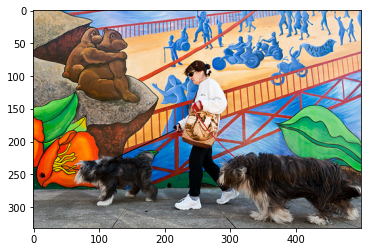

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4748963075.jpg
Real Caption: woman is walking two dogs past mural
Predicted Caption: two children are standing with their dogs are it
BLEU-1 score: 22.22222222222222
BLEU-2 score: 7.031791076575252e-153
BLEU-3 score: 1.6309584783156365e-183
BLEU-4 score: 1.2508498911928378e-229


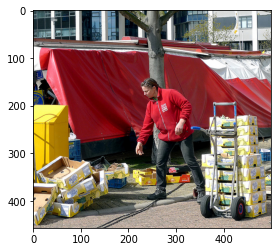

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4508482982.jpg
Real Caption: woman in red jacket looking at boxes that are on the ground
Predicted Caption: man in blue jeans and white walks by restaurant named by graffiti
BLEU-1 score: 8.333333333333332
BLEU-2 score: 4.306075028866568e-153
BLEU-3 score: 1.2152126591739945e-183
BLEU-4 score: 9.788429383461836e-230


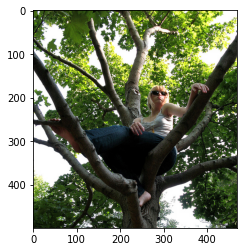

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/1460352062.jpg
Real Caption: the barefoot woman in sunglasses sits in the tree
Predicted Caption: woman in jeans is laying on tree in the middle forest
BLEU-1 score: 45.45454545454545
BLEU-2 score: 30.15113445777636
BLEU-3 score: 2.4648217855445784e-91
BLEU-4 score: 8.190757052088229e-153


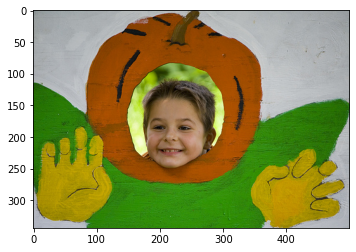

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3756150099.jpg
Real Caption: the child has his head in the frame of the painting
Predicted Caption: child in orange suit holds large bubble bath
BLEU-1 score: 17.182231969774307
BLEU-2 score: 5.126037622123983e-153
BLEU-3 score: 1.1612566946930451e-183
BLEU-4 score: 8.853864984883468e-230


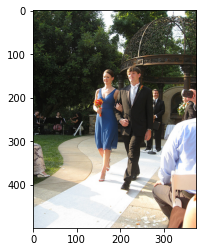

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2667078298.jpg
Real Caption: bridesmaid in blue dress walks down the aisle with
Predicted Caption: three women across the road
BLEU-1 score: 8.986579282344431
BLEU-2 score: 2.997447795420392e-153
BLEU-3 score: 7.100355149153815e-184
BLEU-4 score: 5.474320712955125e-230


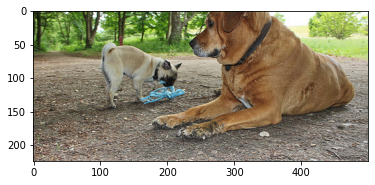

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3610189629.jpg
Real Caption: large dog watching small dog
Predicted Caption: large dog sits on the ground covered with colorful floral grass
BLEU-1 score: 18.181818181818183
BLEU-2 score: 13.483997249264846
BLEU-3 score: 1.5208785072510163e-91
BLEU-4 score: 5.477489369001354e-153


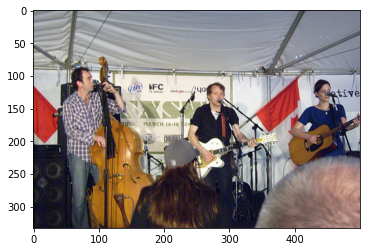

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/428911994.jpg
Real Caption: band is performing in front of an audience
Predicted Caption: group of people wearing black shirts and are outside
BLEU-1 score: 11.111111111111109
BLEU-2 score: 4.972227154133551e-153
BLEU-3 score: 1.3247499323693867e-183
BLEU-4 score: 1.0518351895246306e-229


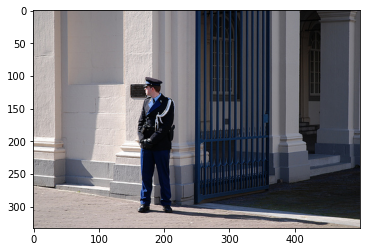

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2404560299.jpg
Real Caption: man in uniform is looking to his right standing by building
Predicted Caption: two men standing on sidewalk
BLEU-1 score: 6.02388423824404
BLEU-2 score: 2.009249344215622e-153
BLEU-3 score: 4.759510390450173e-184
BLEU-4 score: 3.669546912321932e-230


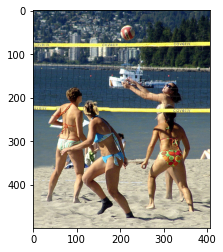

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3271495320.jpg
Real Caption: four women competing in beach volleyball beside large body of water
Predicted Caption: two men competing in red shirts are competing while in front of camera
BLEU-1 score: 23.076923076923077
BLEU-2 score: 13.867504905630728
BLEU-3 score: 1.5466866120248002e-91
BLEU-4 score: 5.554837769749797e-153


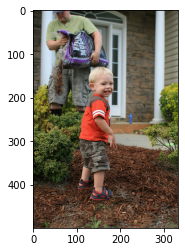

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4530519681.jpg
Real Caption: young toddler smiling at the camera while standing in the garden
Predicted Caption: child in an orange shirt and white cowboy hat
BLEU-1 score: 8.897082254631197
BLEU-2 score: 3.981448258113331e-153
BLEU-3 score: 1.0607768203596798e-183
BLEU-4 score: 8.42243777956461e-230


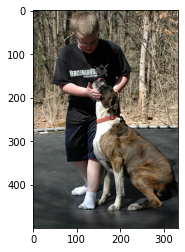

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3373544964.jpg
Real Caption: boy looks at dog while they stand on trampoline outside
Predicted Caption: man and brown dog black skirt and brown dog
BLEU-1 score: 9.942659075715216
BLEU-2 score: 4.4493443496507245e-153
BLEU-3 score: 1.1854383244313044e-183
BLEU-4 score: 9.412234823955333e-230


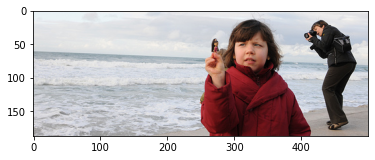

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2393264648.jpg
Real Caption: child on the beach while woman takes pictures nearby
Predicted Caption: two kids walking in the water
BLEU-1 score: 10.10884432854389
BLEU-2 score: 3.693595645692774e-153
BLEU-3 score: 9.074319006831119e-184
BLEU-4 score: 7.060301868108111e-230


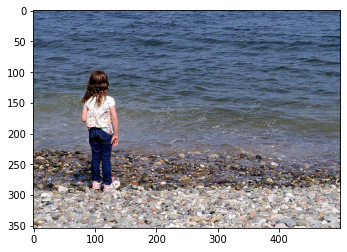

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3443460885.jpg
Real Caption: <unk> girl stands on rocky shore at looks out at the water
Predicted Caption: child in striped shirt and shorts in front of water
BLEU-1 score: 8.18730753077982
BLEU-2 score: 3.862009336171134e-153
BLEU-3 score: 1.0508670198626023e-183
BLEU-4 score: 8.387826279040936e-230


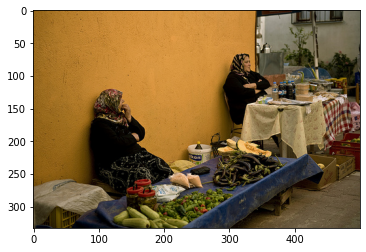

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/5114891455.jpg
Real Caption: older women outside sitting down behind tables of food
Predicted Caption: woman in white apron is sitting on table
BLEU-1 score: 11.031211282307446
BLEU-2 score: 4.6541503835249794e-153
BLEU-3 score: 1.2111358303072744e-183
BLEU-4 score: 9.55980462367717e-230


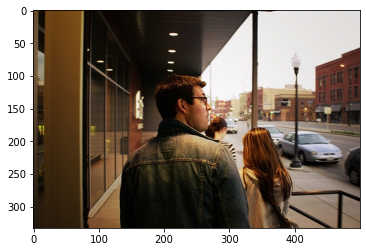

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4589342421.jpg
Real Caption: man in denim jacket is looking at something in the evening
Predicted Caption: woman in suit is standing near an player in the camera while people walk past the background
BLEU-1 score: 23.529411764705884
BLEU-2 score: 12.126781251816652
BLEU-3 score: 1.4270876757460378e-91
BLEU-4 score: 5.194514794593801e-153


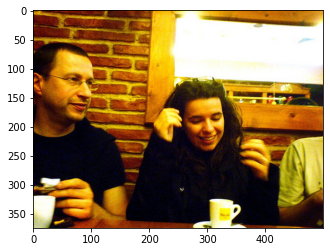

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3543600125.jpg
Real Caption: man and woman are drinking from <unk> cups in front of brick wall
Predicted Caption: man in red shirt holding card as his beer
BLEU-1 score: 14.248453076221212
BLEU-2 score: 4.5086465338368087e-153
BLEU-3 score: 1.0457385906395474e-183
BLEU-4 score: 8.020204191025903e-230


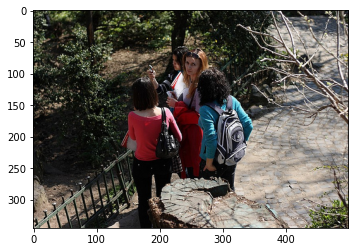

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3423249426.jpg
Real Caption: women are outside
Predicted Caption: three women wearing red backpack standing on rocks
BLEU-1 score: 12.500000000000004
BLEU-2 score: 5.273843307431706e-153
BLEU-3 score: 1.372396692566494e-183
BLEU-4 score: 1.0832677820940878e-229


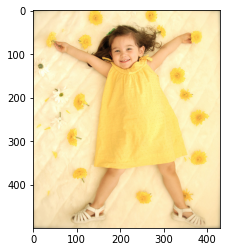

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3565021218.jpg
Real Caption: young girl wearing yellow lays on the ground
Predicted Caption: little girl in red coat is watering can
BLEU-1 score: 12.500000000000004
BLEU-2 score: 5.273843307431706e-153
BLEU-3 score: 1.372396692566494e-183
BLEU-4 score: 1.0832677820940878e-229


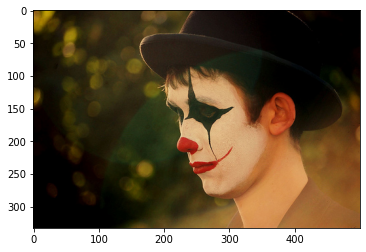

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4914309980.jpg
Real Caption: young man with painted face much like that of clown looks downward with <unk> stare
Predicted Caption: girl with purple shirt has his hair and white gloves
BLEU-1 score: 6.065306597126336
BLEU-2 score: 2.8610468846784813e-153
BLEU-3 score: 7.785014358277125e-184
BLEU-4 score: 6.213854539426459e-230


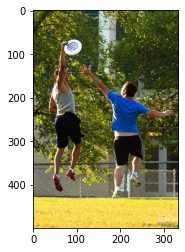

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/7594999748.jpg
Real Caption: two men one in gray shirt and one in blue shirt in playing frisbee
Predicted Caption: two men in blue shirt is running behind four soccer field in baseball field
BLEU-1 score: 42.857142857142854
BLEU-2 score: 31.448545101657547
BLEU-3 score: 23.70314434907367
BLEU-4 score: 3.6799428630948516e-76


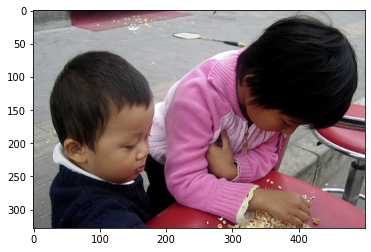

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/274616466.jpg
Real Caption: two young children look at some type of food
Predicted Caption: woman and woman holding baby in the screen shows child smiles
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


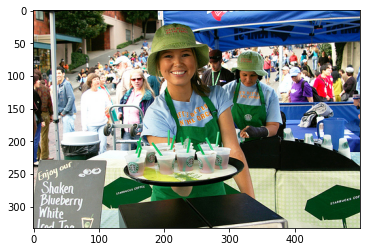

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/1155138244.jpg
Real Caption: the waitress offers <unk> tea to the patrons
Predicted Caption: woman in blue shirt and white blindfold is hitting the background
BLEU-1 score: 9.09090909090909
BLEU-2 score: 4.497548684366688e-153
BLEU-3 score: 1.2473514990254889e-183
BLEU-4 score: 1.0003688322288243e-229


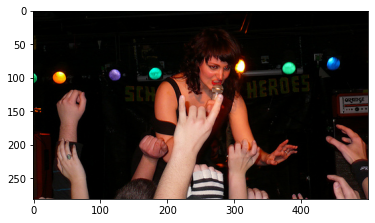

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4203065094.jpg
Real Caption: the singer that is is entertaining an enthusiastic crowd
Predicted Caption: man in blue shirt is singing into microphone
BLEU-1 score: 11.031211282307446
BLEU-2 score: 4.6541503835249794e-153
BLEU-3 score: 1.2111358303072744e-183
BLEU-4 score: 9.55980462367717e-230


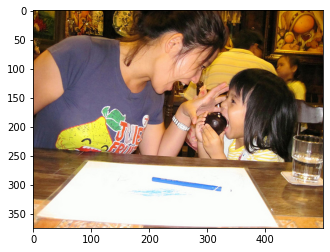

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4978901111.jpg
Real Caption: woman and young girl sharing smiles at table with glass of water on it
Predicted Caption: woman in black shirt is sitting at table wearing blue net to the background
BLEU-1 score: 21.428571428571423
BLEU-2 score: 12.838814775327384
BLEU-3 score: 1.47678845808219e-91
BLEU-4 score: 5.344839673067705e-153


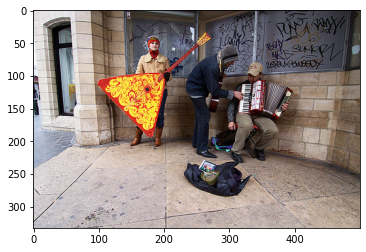

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4587710350.jpg
Real Caption: group of three people stand outside building holding an over sized ukulele and an accordion
Predicted Caption: man in blue jeans and blue jeans is on sidewalk in the street
BLEU-1 score: 6.595414762772626
BLEU-2 score: 3.5472026798688524e-153
BLEU-3 score: 1.0172064784550804e-183
BLEU-4 score: 8.226364521884694e-230


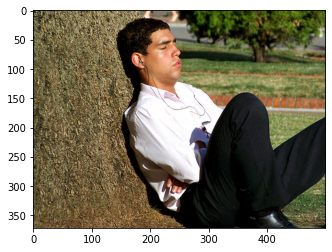

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2219522227.jpg
Real Caption: guy sleeping on pile of grass
Predicted Caption: man in blue hat is looking at beautiful mountain
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


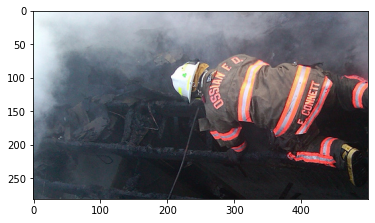

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4269551560.jpg
Real Caption: firefighter is shown trying to climb into some debris
Predicted Caption: person is walking in around on welding
BLEU-1 score: 10.735389901075512
BLEU-2 score: 4.236810678370506e-153
BLEU-3 score: 1.073477903059106e-183
BLEU-4 score: 8.416851712392763e-230


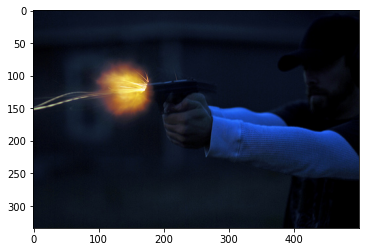

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3372215826.jpg
Real Caption: man shoots gun
Predicted Caption: man breakdances
BLEU-1 score: 30.326532985631673
BLEU-2 score: 6.397495320955232e-153
BLEU-3 score: 1.261683487508958e-183
BLEU-4 score: 9.291879812217675e-230


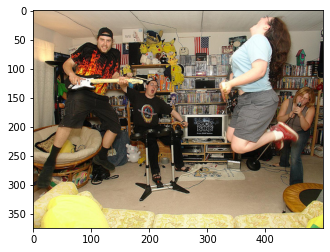

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2644348489.jpg
Real Caption: men and two women are in living area playing the video game rock band
Predicted Caption: man in green shirt is playing the floor while other men with white stick at table mat
BLEU-1 score: 23.529411764705884
BLEU-2 score: 12.126781251816652
BLEU-3 score: 1.4270876757460378e-91
BLEU-4 score: 5.194514794593801e-153


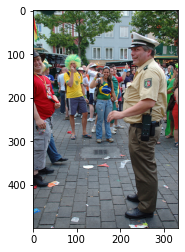

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/170273913.jpg
Real Caption: smiling man in uniform stands on cobblestone street surrounded by <unk> people in clothes
Predicted Caption: group of people dancing or performing on bench
BLEU-1 score: 11.809163818525366
BLEU-2 score: 3.523070700364982e-153
BLEU-3 score: 7.981192761867711e-184
BLEU-4 score: 6.085166479973199e-230


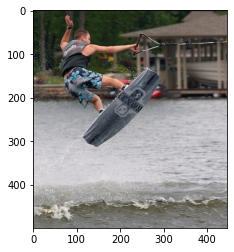

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3555573680.jpg
Real Caption: man in flowered bathing suit <unk> on one ski while being pulled by rope
Predicted Caption: man rides surfboard in midair on surfboard
BLEU-1 score: 15.766261764490386
BLEU-2 score: 3.592438492545047e-153
BLEU-3 score: 7.30666408015247e-184
BLEU-4 score: 5.422750778013804e-230


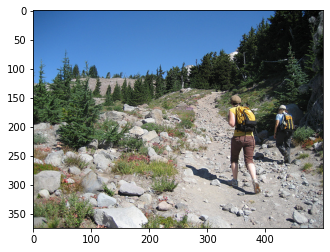

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/1299817309.jpg
Real Caption: two women hiking up gravel trail
Predicted Caption: three people in black are standing at the middle of tall trees with little black mattress and clutching white dog
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


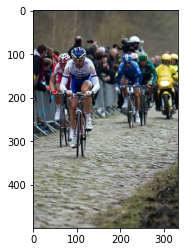

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/7062352447.jpg
Real Caption: bike riders racing on dirt road
Predicted Caption: two cyclists in the street on the finish line
BLEU-1 score: 11.111111111111109
BLEU-2 score: 4.972227154133551e-153
BLEU-3 score: 1.3247499323693867e-183
BLEU-4 score: 1.0518351895246306e-229


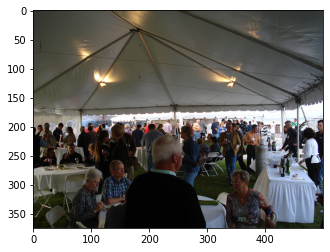

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/1409731198.jpg
Real Caption: people under tent at reception
Predicted Caption: people are sitting on platform in large decorated room
BLEU-1 score: 11.111111111111109
BLEU-2 score: 4.972227154133551e-153
BLEU-3 score: 1.3247499323693867e-183
BLEU-4 score: 1.0518351895246306e-229


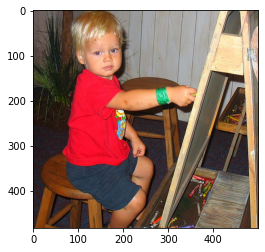

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2642993866.jpg
Real Caption: this little boy is wearing red shirt
Predicted Caption: young girl is holding
BLEU-1 score: 11.809163818525366
BLEU-2 score: 3.523070700364982e-153
BLEU-3 score: 7.981192761867711e-184
BLEU-4 score: 6.085166479973199e-230


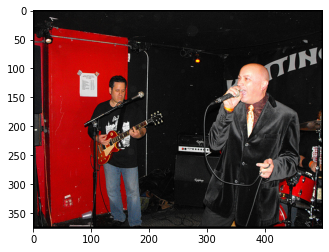

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3094823646.jpg
Real Caption: two men at concert singing
Predicted Caption: two men talking and woman are dressed in front of microphone
BLEU-1 score: 18.181818181818183
BLEU-2 score: 13.483997249264846
BLEU-3 score: 1.5208785072510163e-91
BLEU-4 score: 5.477489369001354e-153


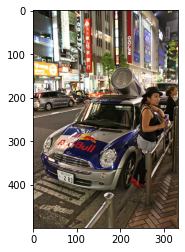

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4668777411.jpg
Real Caption: woman in black hat and black shirt standing in front of red bull car
Predicted Caption: person rides white helmet is on the street next to
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


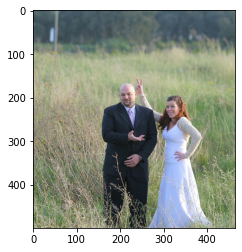

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/439584948.jpg
Real Caption: bride and groom are standing in <unk> making poses for picture
Predicted Caption: man and woman sitting by pond
BLEU-1 score: 7.243303475117973
BLEU-2 score: 2.646576928737885e-153
BLEU-3 score: 6.502033690529349e-184
BLEU-4 score: 5.058927350602078e-230


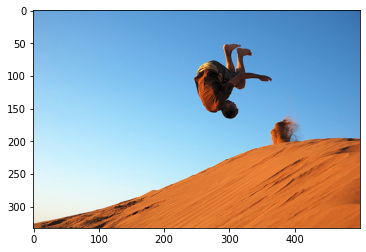

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/5110481785.jpg
Real Caption: man in and shorts doing backflip on sand hill
Predicted Caption: man in midair from large boulder with throwing
BLEU-1 score: 22.062422564614888
BLEU-2 score: 16.677623835883093
BLEU-3 score: 1.6434977345885395e-91
BLEU-4 score: 5.722633035689358e-153


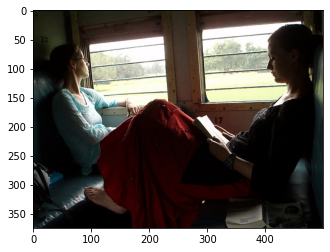

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/246581414.jpg
Real Caption: two girls riding train one in skirt is reading book the other in blue shirt and glasses is looking out the window
Predicted Caption: woman with dark jacket is standing in yellow dog on public transportation
BLEU-1 score: 7.243303475117973
BLEU-2 score: 2.646576928737885e-153
BLEU-3 score: 6.502033690529349e-184
BLEU-4 score: 5.058927350602078e-230


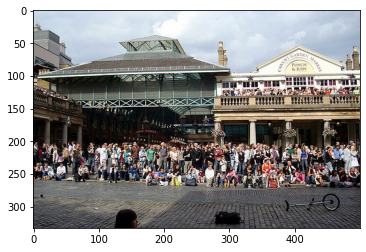

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2755554894.jpg
Real Caption: <unk> unicycle in front of crowd
Predicted Caption: group of people standing around building
BLEU-1 score: 16.666666666666668
BLEU-2 score: 6.08970970641905e-153
BLEU-3 score: 1.4961022763680928e-183
BLEU-4 score: 1.1640469867513693e-229


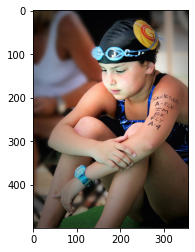

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/652542470.jpg
Real Caption: kid sits wearing swim gear
Predicted Caption: young girl wearing red shirt with the next to throw the ball
BLEU-1 score: 8.333333333333332
BLEU-2 score: 4.306075028866568e-153
BLEU-3 score: 1.2152126591739945e-183
BLEU-4 score: 9.788429383461836e-230


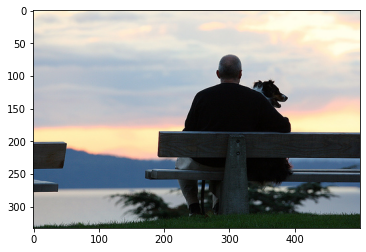

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/1489286545.jpg
Real Caption: man holds his dog near pond
Predicted Caption: man in suit is sitting on wooden bench
BLEU-1 score: 12.500000000000004
BLEU-2 score: 5.273843307431706e-153
BLEU-3 score: 1.372396692566494e-183
BLEU-4 score: 1.0832677820940878e-229


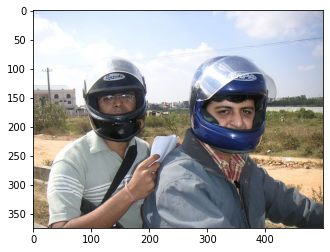

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/6905083.jpg
Real Caption: two men wearing motorcycle helmets one carrying piece of paper
Predicted Caption: man and woman in green shirts with white dog
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


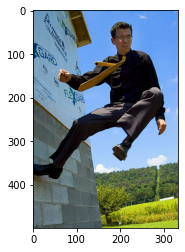

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2774501339.jpg
Real Caption: young man dressed up with yellow tie jumps against wall and one foot is left against the wall to push away
Predicted Caption: man wearing dark shirt playing guitar on the street with his arms outstretched and microphone in his hand
BLEU-1 score: 18.8107049975692
BLEU-2 score: 5.952282639569847e-153
BLEU-3 score: 1.380576545949591e-183
BLEU-4 score: 1.0588215734761504e-229


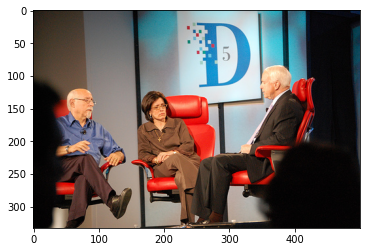

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/526847964.jpg
Real Caption: two men one being john <unk> and one woman sitting in red rolling chairs next to white sign with blue letter and number on it
Predicted Caption: two men working with sofa
BLEU-1 score: 1.0989383333240506
BLEU-2 score: 0.7093616439121639
BLEU-3 score: 5.246295871436384e-93
BLEU-4 score: 1.700266910165314e-154


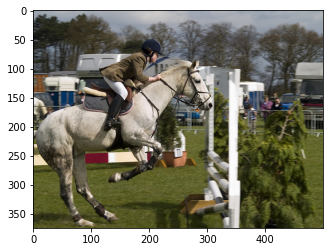

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/448493587.jpg
Real Caption: young rider on white horse about to jump hurdle
Predicted Caption: two men on horses chasing bull
BLEU-1 score: 10.10884432854389
BLEU-2 score: 3.693595645692774e-153
BLEU-3 score: 9.074319006831119e-184
BLEU-4 score: 7.060301868108111e-230


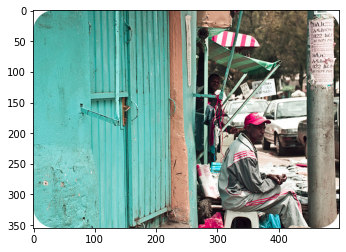

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2764336070.jpg
Real Caption: teal blue house on the corner of street with man sitting out front
Predicted Caption: two men talking on brick wall
BLEU-1 score: 5.190053731909963
BLEU-2 score: 1.896355235282911e-153
BLEU-3 score: 4.658910721669926e-184
BLEU-4 score: 3.6248798446244946e-230


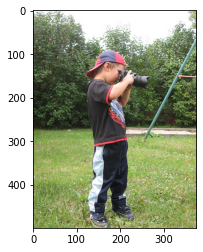

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2588927489.jpg
Real Caption: little boy takes picture at the park
Predicted Caption: little boy wearing red shirt and jeans is raking across his face
BLEU-1 score: 16.666666666666668
BLEU-2 score: 12.309149097933275
BLEU-3 score: 1.4399259176082162e-91
BLEU-4 score: 5.233427736988301e-153


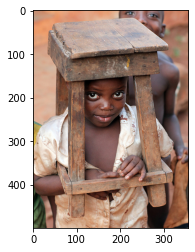

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4868905774.jpg
Real Caption: young boy carrying stool for big event in his village
Predicted Caption: child in green and mustache and hat
BLEU-1 score: 9.306272250443651
BLEU-2 score: 3.672797542504966e-153
BLEU-3 score: 9.305742700321069e-184
BLEU-4 score: 7.296382734947758e-230


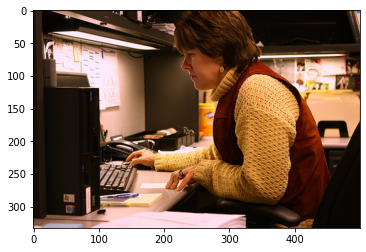

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4541692312.jpg
Real Caption: an older woman on the computer
Predicted Caption: woman sits at table in bowl
BLEU-1 score: 16.666666666666668
BLEU-2 score: 6.08970970641905e-153
BLEU-3 score: 1.4961022763680928e-183
BLEU-4 score: 1.1640469867513693e-229


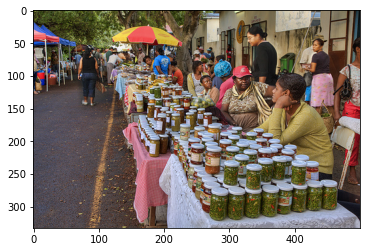

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4392254315.jpg
Real Caption: street market crowded with customers vendors and their wares
Predicted Caption: some people are shopping in the street the street market
BLEU-1 score: 20.0
BLEU-2 score: 14.9071198499986
BLEU-3 score: 1.6152493512830776e-91
BLEU-4 score: 5.75929185611095e-153


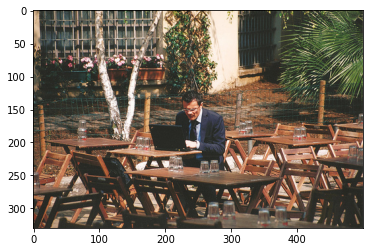

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4882033971.jpg
Real Caption: man in blue suit sits at table with laptop
Predicted Caption: man in white apron is sitting on their instruments
BLEU-1 score: 22.22222222222222
BLEU-2 score: 16.666666666666668
BLEU-3 score: 1.7270804940051994e-91
BLEU-4 score: 6.08970970641905e-153


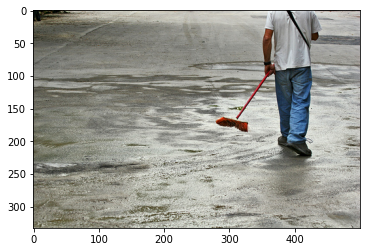

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/520341293.jpg
Real Caption: someone is sweeping in the street
Predicted Caption: little boy stands on the street
BLEU-1 score: 33.33333333333333
BLEU-2 score: 25.819888974716115
BLEU-3 score: 2.2458252053838132e-91
BLEU-4 score: 7.57965434483665e-153


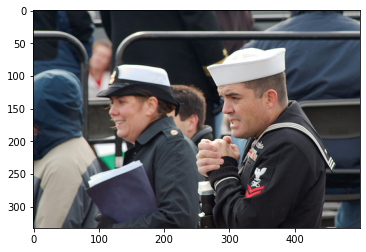

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3025740991.jpg
Real Caption: man in black sailor uniform and white hat <unk> his hands together and <unk> his teeth
Predicted Caption: man kissing boy passengers
BLEU-1 score: 1.2446767091965987
BLEU-2 score: 3.713289198950934e-154
BLEU-3 score: 8.41211528179621e-185
BLEU-4 score: 6.413718283190248e-231


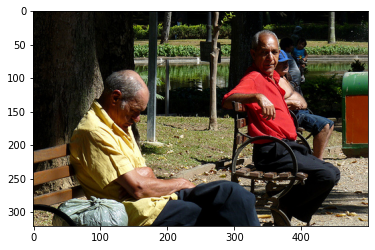

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4571898363.jpg
Real Caption: an older gentleman wearing red shirt watches another older gentleman who is sleeping in seated position on park bench
Predicted Caption: two men with shopping cart through through swampy area
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


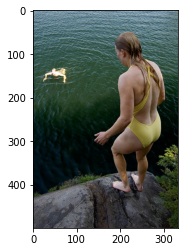

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/1801063894.jpg
Real Caption: girl in yellow bathing suit stands on rock over body of water
Predicted Caption: little girl in the flowered shorts in lake while jumping into the beach
BLEU-1 score: 15.384615384615385
BLEU-2 score: 11.322770341445958
BLEU-3 score: 1.36954071726339e-91
BLEU-4 score: 5.019362538473706e-153


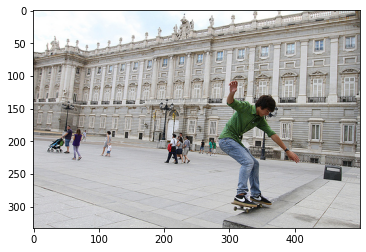

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4941360966.jpg
Real Caption: kid skateboarding on the steps of an outside plaza
Predicted Caption: rollerbladers are skating through an electric guitar
BLEU-1 score: 10.735389901075512
BLEU-2 score: 4.236810678370506e-153
BLEU-3 score: 1.073477903059106e-183
BLEU-4 score: 8.416851712392763e-230


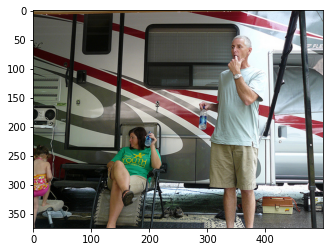

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4804949713.jpg
Real Caption: man woman and young girl rest with water in front of camper
Predicted Caption: two men working on scaffolding
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


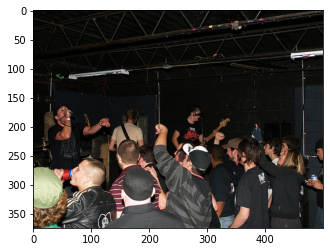

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2127570593.jpg
Real Caption: band on stage signing to group of fans
Predicted Caption: group of musicians perform in large crowd of event
BLEU-1 score: 22.22222222222222
BLEU-2 score: 16.666666666666668
BLEU-3 score: 1.7270804940051994e-91
BLEU-4 score: 6.08970970641905e-153


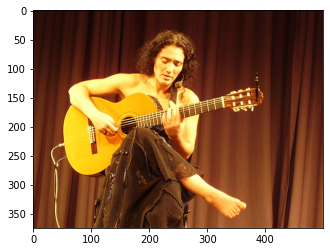

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/336411072.jpg
Real Caption: topless woman playing guitar
Predicted Caption: woman in formal gown plays the guitar and singing
BLEU-1 score: 22.22222222222222
BLEU-2 score: 7.031791076575252e-153
BLEU-3 score: 1.6309584783156365e-183
BLEU-4 score: 1.2508498911928378e-229


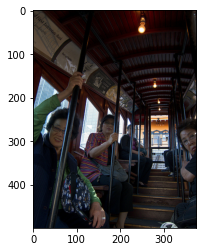

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4868909807.jpg
Real Caption: several women sit holding <unk> on an incline <unk>
Predicted Caption: woman with white shirt is on bus with white shirts are on the window
BLEU-1 score: 7.1428571428571415
BLEU-2 score: 3.986650812853149e-153
BLEU-3 score: 1.1602945388103906e-183
BLEU-4 score: 9.418382295637229e-230


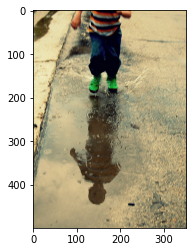

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2441354291.jpg
Real Caption: the little boy is jumping into puddle on the street
Predicted Caption: little boy stands on sidewalk
BLEU-1 score: 22.07276647028654
BLEU-2 score: 14.247909490690875
BLEU-3 score: 1.0537466943570253e-91
BLEU-4 score: 3.4150773803399635e-153


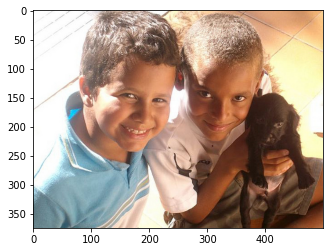

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/6887015851.jpg
Real Caption: two young boys pose with puppy for family picture
Predicted Caption: man is kissing the reflection and woman in the camera
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


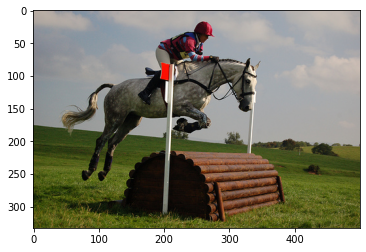

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/238573199.jpg
Real Caption: jockey riding horse over jump
Predicted Caption: man is on the air while little kid in the horse with both front legs off the background
BLEU-1 score: 5.555555555555554
BLEU-2 score: 3.5158955382876193e-153
BLEU-3 score: 1.0760313071397887e-183
BLEU-4 score: 8.844844403089351e-230


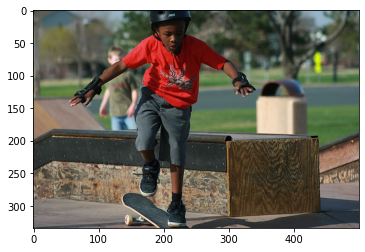

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/511749704.jpg
Real Caption: little boy with red shirt and gray shorts does trick on skateboard
Predicted Caption: young boy is skating through skating
BLEU-1 score: 6.1313240195240395
BLEU-2 score: 2.2402790036937483e-153
BLEU-3 score: 5.503852693656168e-184
BLEU-4 score: 4.282289549833951e-230


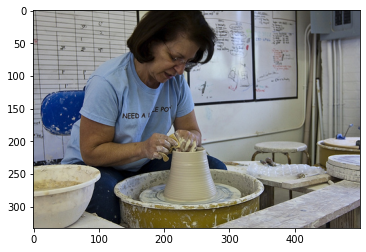

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/6214239936.jpg
Real Caption: woman is spinning piece of pottery on her pottery wheel
Predicted Caption: man over to watch and carving an object
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


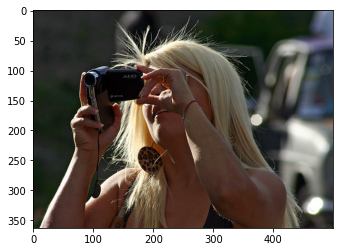

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4953342723.jpg
Real Caption: blond woman with leopard print earrings records video
Predicted Caption: woman in black shirt is looking down in crowded location
BLEU-1 score: 10.000000000000002
BLEU-2 score: 4.717068855239749e-153
BLEU-3 score: 1.2835318765197404e-183
BLEU-4 score: 1.0244914152188952e-229


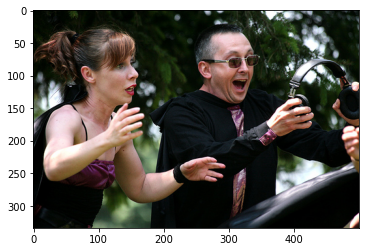

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3604383863.jpg
Real Caption: an excited couple reaching for large black set of earphones
Predicted Caption: man in red shirt is dress is standing outside
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


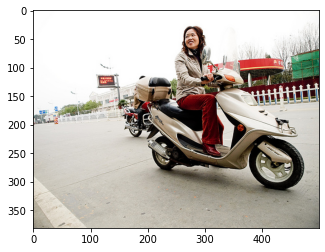

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3056784295.jpg
Real Caption: woman in red pants and boots sits on <unk> colored motor scooter
Predicted Caption: bikers in red moped
BLEU-1 score: 6.766764161830635
BLEU-2 score: 5.525039802078983
BLEU-3 score: 4.001004045483457e-92
BLEU-4 score: 1.289868507023299e-153


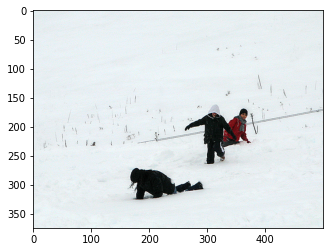

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3190677999.jpg
Real Caption: three little boys play in large snow covered field
Predicted Caption: two people are shoveling snow near large snow
BLEU-1 score: 22.062422564614888
BLEU-2 score: 16.677623835883093
BLEU-3 score: 1.6434977345885395e-91
BLEU-4 score: 5.722633035689358e-153


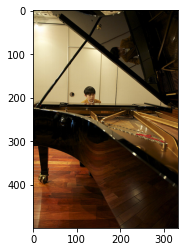

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/5293561334.jpg
Real Caption: little boy sitting in front of very large beautiful shiny black piano
Predicted Caption: two men stand on bridge
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


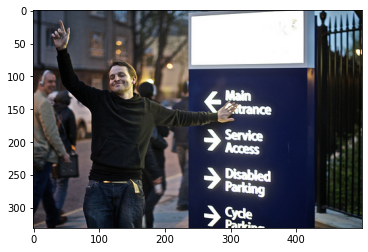

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4555536027.jpg
Real Caption: man wearing black shirt and denim jeans is striking pose with his left hand on sign
Predicted Caption: two men wearing shirts are kissing woman in front of building
BLEU-1 score: 5.770331081275289
BLEU-2 score: 2.854757945924487e-153
BLEU-3 score: 7.917394236512313e-184
BLEU-4 score: 6.3497053018839555e-230


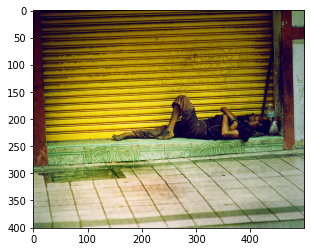

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4631265529.jpg
Real Caption: very thin man is sleeping on the street
Predicted Caption: woman sleeping on the blue shirt and reading newspaper
BLEU-1 score: 33.33333333333333
BLEU-2 score: 28.867513459481287
BLEU-3 score: 26.467700653516886
BLEU-4 score: 4.034282314146679e-76


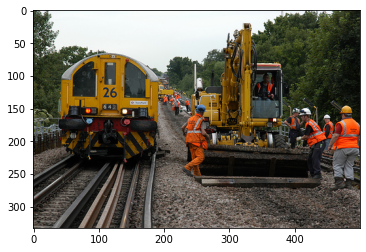

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2537584620.jpg
Real Caption: construction crew working on railroad
Predicted Caption: group of people are around on green roller coaster
BLEU-1 score: 11.111111111111109
BLEU-2 score: 4.972227154133551e-153
BLEU-3 score: 1.3247499323693867e-183
BLEU-4 score: 1.0518351895246306e-229


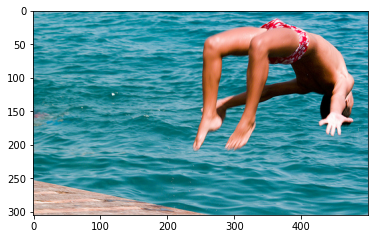

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2819466992.jpg
Real Caption: man in red swimsuit doing back dive into blue waters
Predicted Caption: man is in the waters of water
BLEU-1 score: 27.91881675133095
BLEU-2 score: 6.361471949532527e-153
BLEU-3 score: 1.2938603872273248e-183
BLEU-4 score: 9.602579706020655e-230


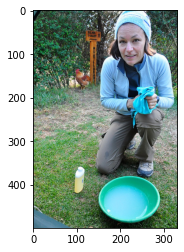

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3826423659.jpg
Real Caption: woman in blue hat and shirt washes bowl and there is rooster in the background
Predicted Caption: girl with dirty towards her father on making an
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


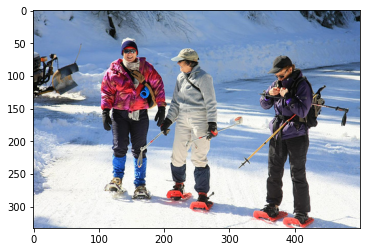

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3291979978.jpg
Real Caption: three friends are laughing on skiing trip
Predicted Caption: two girls in red is standing in front of them walk down street
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


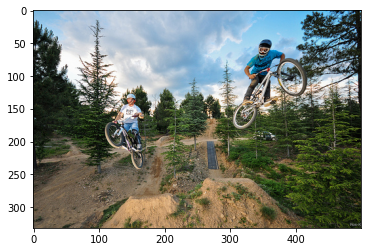

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/5748015019.jpg
Real Caption: two bmx riders airborne having just hit large dirt ramp
Predicted Caption: person wearing red shirt is doing trick atop paved trail
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


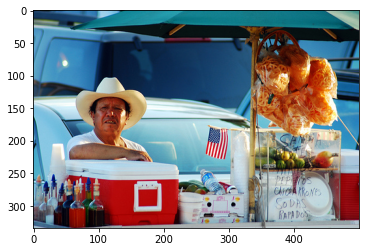

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4787867133.jpg
Real Caption: man sells mexican food by parking lot
Predicted Caption: woman in an orange shirt is leaning against the restroom while sitting at festival
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


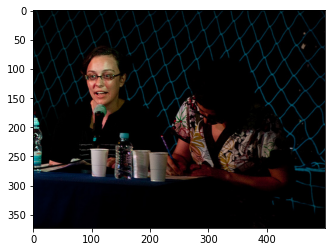

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3643684616.jpg
Real Caption: women wearing black top and glasses speaking into blue <unk> microphone with another woman beside her writing
Predicted Caption: man in blue shirt plays in restaurant
BLEU-1 score: 3.423586234882512
BLEU-2 score: 1.3511467074725742e-153
BLEU-3 score: 3.423391424279344e-184
BLEU-4 score: 2.684189203105542e-230


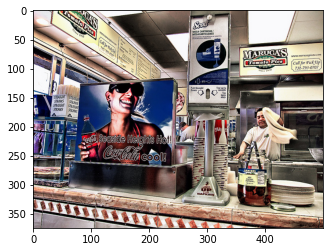

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4582536661.jpg
Real Caption: large advertisement for coca cola sits on the counter of quick service restaurant where worker can be seen preparing dough
Predicted Caption: woman wearing blue shirt is standing at the background behind machine
BLEU-1 score: 4.011210615999854
BLEU-2 score: 1.984467653157862e-153
BLEU-3 score: 5.50372853225181e-184
BLEU-4 score: 4.413959087726801e-230


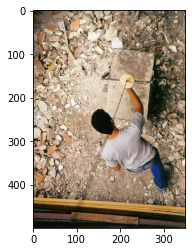

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/227441355.jpg
Real Caption: this man is pulling some rocks out of pit with box attached to rope
Predicted Caption: boy in blue shirt is playing with yellow belt is jumping off of bottom of shoe
BLEU-1 score: 18.75
BLEU-2 score: 6.459112543299825e-153
BLEU-3 score: 1.549911998981145e-183
BLEU-4 score: 1.198832868637291e-229


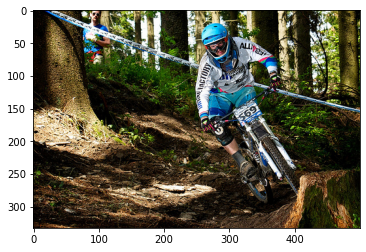

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/7340952802.jpg
Real Caption: motor cross mountain bike racer is on very <unk> ride
Predicted Caption: man wearing helmet and red backpack on trail
BLEU-1 score: 9.735009788392563
BLEU-2 score: 4.1072732976237013e-153
BLEU-3 score: 1.0688236188553917e-183
BLEU-4 score: 8.436497969708995e-230


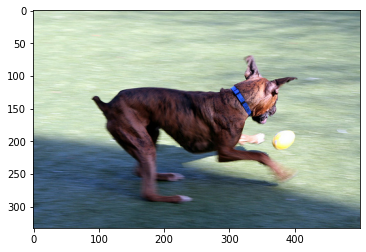

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/422756764.jpg
Real Caption: brown dog is playing ball in yard
Predicted Caption: brown dog with blue color dog is running on the ocean with ball
BLEU-1 score: 30.769230769230766
BLEU-2 score: 22.64554068289192
BLEU-3 score: 2.0758355536666792e-91
BLEU-4 score: 7.098450576376767e-153


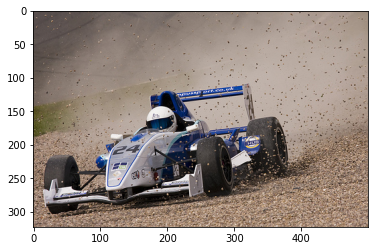

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3559374748.jpg
Real Caption: person is in race car on track with lot <unk>
Predicted Caption: person rides his toy car on dirt bike
BLEU-1 score: 29.20502936517768
BLEU-2 score: 18.02573546715273
BLEU-3 score: 1.6379840831661966e-91
BLEU-4 score: 5.588971591971542e-153
BLEU-1 count: 118
BLEU-2 count: 42
BLEU-3 count: 9
BLEU-4 count: 0
BLEU-1 Total: 24.363221217530384
BLEU-2 Total: 8.230319968133353
BLEU-3 Total: 2.2253201449055457
BLEU-4 Total: 0
BLEU-1 Average: 0.206467976419749
BLEU-2 Average: 0.1959599992412703
BLEU-3 Average: 0.24725779387839397


'\nprint(f"BLEU-1 count: {blue_count_1}", f"BLEU-1 Average: {blue_1/blue_count_1}")\nprint(f"BLEU-1 count: {blue_count_2}",f"BLEU-1 Average: {blue_2/blue_count_2}")\nprint(f"BLEU-1 count: {blue_count_3}",f"BLEU-1 Average: {blue_3/blue_count_3}")\nprint(f"BLEU-1 count: {blue_count_4}",f"BLEU-1 Average: {blue_4/blue_count_4}")\n'

In [92]:
blue_1 = 0
blue_2 = 0
blue_3 = 0
blue_4 = 0
blue_count_1 = 0
blue_count_2 = 0
blue_count_3 = 0
blue_count_4 = 0
for j in range(200):
    start_token = tokenizer.word_index['<start>']
    end_token = tokenizer.word_index['<end>']
    # select random image from validation data
    rid = np.random.randint(0, len(img_name_val))
    image = img_name_val[rid]
    temp_image = np.array(Image.open(image))
    plt.imshow(temp_image)
    plt.show()
    real_caption = ' '.join([tokenizer.index_word[i] for i in cap_val[rid] if i not in [0]])
    caption,result,attention_weights = evaluate(image)
    first = real_caption.split(' ', 1)[1]
    real_caption = first.rsplit(' ', 1)[0]

    #remove "<unk>" in result
    for i in caption:
        if i=="<unk>":
            caption.remove(i)

    for i in real_caption:
        if i=="<unk>":
            real_caption.remove(i)

    #remove <end> from result         
    result_join = ' '.join(caption)
    result_final = result_join.rsplit(' ', 1)[0]

    real_appn = []
    real_appn.append(real_caption.split())
    reference = real_appn
    candidate = caption
    print("image",image)
    print ('Real Caption:', real_caption)
    print ('Predicted Caption:', ' '.join(caption))
    score = sentence_bleu(reference, candidate, weights=(1.0,0,0,0))
    if score > 0.1:
        blue_1 +=score
        blue_count_1 +=1
    print(f"BLEU-1 score: {score*100}")
    score = sentence_bleu(reference, candidate, weights=(0.5,0.5,0,0))
    if score > 0.1:
        blue_2 +=score
        blue_count_2 +=1
    print(f"BLEU-2 score: {score*100}")
    score = sentence_bleu(reference, candidate, weights=(0.3,0.3,0.3,0))
    if score > 0.1:
        blue_3 +=score
        blue_count_3 += 1
    print(f"BLEU-3 score: {score*100}")
    score = sentence_bleu(reference, candidate, weights=(0.25,0.25,0.25,0.25))
    if score > 0.1:
        blue_4 +=score
        blue_count_4 += 1
    print(f"BLEU-4 score: {score*100}")

print(f"BLEU-1 count: {blue_count_1}")
print(f"BLEU-2 count: {blue_count_2}")
print(f"BLEU-3 count: {blue_count_3}")
print(f"BLEU-4 count: {blue_count_4}")
print(f"BLEU-1 Total: {blue_1}")
print(f"BLEU-2 Total: {blue_2}")
print(f"BLEU-3 Total: {blue_3}")
print(f"BLEU-4 Total: {blue_4}")
if blue_count_1 > 0:
    print(f"BLEU-1 Average: {blue_1/blue_count_1}")
if blue_count_2 > 0:
    print(f"BLEU-2 Average: {blue_2/blue_count_2}")
if blue_count_3 > 0:
    print(f"BLEU-3 Average: {blue_3/blue_count_3}")
if blue_count_4 > 0:
    print(f"BLEU-4 Average: {blue_4/blue_count_4}")
"""
print(f"BLEU-1 count: {blue_count_1}", f"BLEU-1 Average: {blue_1/blue_count_1}")
print(f"BLEU-1 count: {blue_count_2}",f"BLEU-1 Average: {blue_2/blue_count_2}")
print(f"BLEU-1 count: {blue_count_3}",f"BLEU-1 Average: {blue_3/blue_count_3}")
print(f"BLEU-1 count: {blue_count_4}",f"BLEU-1 Average: {blue_4/blue_count_4}")
"""